# **Laboratorio 1 unidad 2  Morfología matemática**

# **Librerias**

In [37]:
!pip install pythreshold
import os
import numpy as np
import cv2 as cv 
import io as io
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpi
from PIL import Image
from codecs import utf_16_be_decode
from skimage.filters import threshold_isodata, threshold_otsu, threshold_sauvola, threshold_niblack
from skimage import img_as_ubyte
from scipy.ndimage import grey_erosion, grey_dilation, grey_closing, grey_opening, binary_erosion,binary_dilation, white_tophat, black_tophat, binary_opening
import doxapy
from pythreshold.global_th.entropy.kapur import kapur_threshold

# Leer a escala de grises

In [38]:
def readGrayscaleimage(path): #check
    #read image GBR or grayScale 
    image = cv.imread(path)
    
    arrayImage = np.asarray(image)
    if arrayImage.ndim == 3:
        image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
        image = cv.cvtColor(image, cv.COLOR_RGB2GRAY)

    return image

# **Leer archivos**

In [39]:
def readDirectory(path):
    try:
        example_directory = path
        content = os.listdir(example_directory)
        names = []
        for file in content:
            if os.path.isfile(os.path.join(example_directory, file)):
                names.append(file)
        return names
    except FileNotFoundError:
        print("The specified path wasn't found.")
        return []

# **1. Elemento estructural**

## 1. 1. Codigo 

In [41]:
class Structural_element:
    @classmethod
    def vertical_line(cls, size=5):
        try:
            if size % 2 == 0:
                raise ValueError('The size of the mask must be odd.')
                raise Exception('This is the exception you expect to handle.')

            mask = np.zeros(shape=(size,size), dtype=np.uint8)
            middle_index = size // 2
            mask[:, middle_index] = 1
            mask[middle_index, middle_index] = 0

        except Exception as error:
            print('Caught this error: ' + repr(error))
        else: 
            return mask, middle_index
    @classmethod
    def horizontal_line(cls, size=5):
        try:
            if size % 2 == 0:
                raise ValueError('The size of the mask must be odd.')
                raise Exception('This is the exception you expect to handle.')

            mask = np.zeros(shape=(size,size), dtype=np.uint8)
            middle_index = size // 2
            mask[ middle_index, :] = 1
            mask[middle_index, middle_index] = 0
            
        except Exception as error:
            print('Caught this error: ' + repr(error))
        else: 
            return mask, middle_index
    @classmethod
    def cross(cls, size=5):
        try:
            if size % 2 == 0:
                raise ValueError('The size of the mask must be odd.')
                raise Exception('This is the exception you expect to handle.')

            mask = np.zeros(shape=(size,size), dtype=np.uint8)
            middle_index = size // 2
            mask[ :, middle_index] = 1
            mask[ middle_index, :] = 1
            mask[middle_index, middle_index] = 0
            
        except Exception as error:
            print('Caught this error: ' + repr(error))
        else: 
            return mask, middle_index
    @classmethod
    def square(cls, size=5):
        try:
            if size % 2 == 0:
                raise ValueError('The size of the mask must be odd.')
                raise Exception('This is the exception you expect to handle.')

            mask = np.ones(shape=(size,size), dtype=np.uint8)
            middle_index = size // 2
            mask[middle_index, middle_index] = 0

        except Exception as error:
            print('Caught this error: ' + repr(error))
        else: 
            return mask, middle_index
    @classmethod
    def diamond(cls, size=5):
        try:
            if size % 2 == 0:
                raise ValueError('The size of the mask must be odd.')
                raise Exception('This is the exception you expect to handle.')

            mask = np.zeros(shape=(size,size),dtype=np.uint8)
            middle_index = size // 2

            for i in  range(middle_index + 1):
                mask[i, middle_index - i: middle_index + i + 1] = 1
                mask[size - i -1, middle_index - i: middle_index + i + 1] = 1
            mask[middle_index, middle_index] = 0

        except Exception as error:
            print('Caught this error: ' + repr(error))
        else: 
            return mask, middle_index

    @classmethod
    def circle(cls, size=5):
        try:
            if size % 2 == 0:
                raise ValueError('The size of the mask must be odd.')
                raise Exception('This is the exception you expect to handle.')

            mask = np.zeros(shape=(size,size))
            middle_index = size // 2

            x_coords, y_coords = np.meshgrid(np.arange(size), np.arange(size))
            distances = np.sqrt((x_coords - middle_index)**2 + (y_coords - middle_index)**2)

            mask[distances <= (size - middle_index)] = 1
            mask[middle_index, middle_index] = 0
            
            mask.astype(np.uint8)


        except Exception as error:
            print('Caught this error: ' + repr(error))
        else: 
            return mask, middle_index

# **1. 2. Prueba** 

In [42]:
def showStructuralElements(size=5):
    
    # I have 6 estructural elements. 
    vertical_line = Structural_element.vertical_line(size=size)[0] * 255
    horizontal_line = Structural_element.horizontal_line(size=size)[0] * 255
    cross = Structural_element.cross(size=size)[0] * 255
    square = Structural_element.square(size=size)[0] * 255
    diamond = Structural_element.diamond(size=size)[0] * 255
    circle = Structural_element.circle(size=size)[0] * 255
    
    
    #original image
    plt.subplot(1,6,1)
    plt.imshow(vertical_line, cmap= plt.cm.gray)
    plt.title('Vertical Line', fontsize=8)
    plt.axis('off')
    
    #original image
    plt.subplot(1,6,2)
    plt.imshow(horizontal_line, cmap= plt.cm.gray)
    plt.title('Horizontal Line', fontsize=8)
    plt.axis('off')
    
    #original image
    plt.subplot(1,6,3)
    plt.imshow(cross, cmap= plt.cm.gray)
    plt.title('Cross', fontsize=8)
    plt.axis('off')
    
    #original image
    plt.subplot(1,6,4)
    plt.imshow(square, cmap= plt.cm.gray)
    plt.title('Square', fontsize=8)
    plt.axis('off')
    
    #original image
    plt.subplot(1,6,5)
    plt.imshow(diamond, cmap= plt.cm.gray)
    plt.title('Diamond', fontsize=8)
    plt.axis('off')
    
    #original image
    plt.subplot(1,6,6)
    plt.imshow(circle, cmap= plt.cm.gray)
    plt.title('Circle', fontsize=8)
    plt.axis('off')

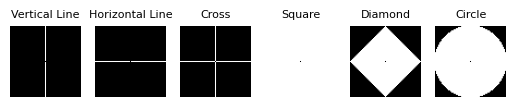

In [43]:
showStructuralElements(size=65)

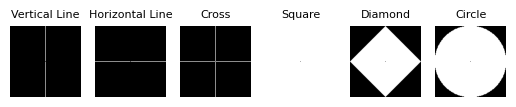

In [13]:
showStructuralElements(size=127)

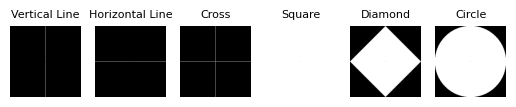

In [14]:
showStructuralElements(size=255)

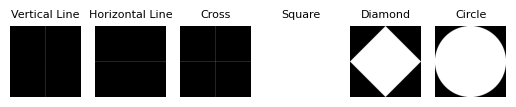

In [15]:
showStructuralElements(size=511)

# 2. Padding

# **2. 1. Código**

In [45]:
class Padding:
    @classmethod
    def zero_padding(cls, array,mask):
        try:
            if mask.shape[0] != mask.shape[1]:
                raise ValueError('The mask does not have dimensions of equal length.')
                raise Exception('This is the exception you expect to handle.')
            if mask.shape[0] % 2 == 0:
                raise ValueError('The size of the mask must be odd.')
                raise Exception('This is the exception you expect to handle.')

            pad_size = mask.shape[0] // 2 #padding size

            padding_template = np.zeros(shape=(array.shape[0]+2*pad_size,array.shape[1]+2*pad_size))

            # add values on template 

            for i in range(0, array.shape[0]):
                for j in range(0, array.shape[1]):
                    padding_template[i + pad_size, j + pad_size] = array[i,j]

        except Exception as error:
            print('Caught this error: ' + repr(error))
        else: 
            return padding_template
        
    @classmethod
    def reflex_padding(cls, array,mask):
        template = Padding.zero_padding(array,mask)
        number_layers = mask.shape[0] // 2
        size_padding = number_layers
        for layer in range(0, number_layers): 
            template[size_padding - layer - 1,:] = template[layer + size_padding,:] # mirror top
            template[size_padding + (array.shape[0] - 1) + 1 + layer,:] = template[ size_padding + (array.shape[0]-1)  - layer,:] # mirror bottom
            template[:,size_padding + (array.shape[1] - 1) + 1 + layer] = template[ :,size_padding + (array.shape[1]-1)  - layer] # reflect right
            template[ : , size_padding - layer - 1] = template[ : , layer + size_padding] # reflect left
        return template
    
    @classmethod
    def crox_reflex_padding(cls, array,mask):
        template = Padding.zero_padding(array,mask)
        number_layers = mask.shape[0] // 2
        size_padding = number_layers
        for layer in range(0, number_layers): 
            template[size_padding - layer - 1,:] = template[size_padding + (array.shape[0]-1)  - layer,:] # mirror top
            template[size_padding + (array.shape[0] - 1) + 1 + layer,:] = template[ layer + size_padding,:] # mirror bottom
            template[:,size_padding + (array.shape[1] - 1) + 1 + layer] = template[ : , layer + size_padding] # reflect right
            template[ : , size_padding - layer - 1] = template[ :,size_padding + (array.shape[1]-1)  - layer] # reflect left
        return template

# **2. 2. Prueba**

In [46]:
def showPadding(pathImage, mask_size):
    
    mask = np.zeros(shape=(mask_size, mask_size))
    
    #read image with gray scale
    grayImage = readGrayscaleimage(pathImage)
    grayImage = np.asarray(grayImage)
    extension = '.png'
    if pathImage.find('.jpg') != -1:
         extension = '.jpg'
    if pathImage.find('.png') != -1:
         extension = '.png'
    
    plt.figure(figsize=(24,7))
    
            
    #original image
    plt.subplot(1,4,1)
    plt.imshow(grayImage, cmap= plt.cm.gray)
    plt.title(f'Original: {pathImage}', fontsize=22)
    plt.axis('off')
    
    #zero padding
    copy1 = np.copy(grayImage)
    zero_template = Padding.zero_padding(copy1,mask)
    #show image
    plt.subplot(1,4,2)
    plt.imshow(zero_template, cmap= plt.cm.gray)
    plt.title('Zero Padding', fontsize=22)
    plt.axis('off')
    
    #reflex padding
    copy2 = np.copy(grayImage)
    reflex_template = Padding.reflex_padding(copy2,mask)
    #show image
    plt.subplot(1,4,3)
    plt.imshow(reflex_template, cmap= plt.cm.gray)
    plt.title('Reflex Padding', fontsize=22)
    plt.axis('off')
    
    #cross reflex padding
    copy3 = np.copy(grayImage)
    cross_template = Padding.crox_reflex_padding(copy3,mask)
    #show image
    plt.subplot(1,4,4)
    plt.imshow(cross_template, cmap= plt.cm.gray)
    plt.title('Cross Reflex Padding', fontsize=22)
    plt.axis('off')


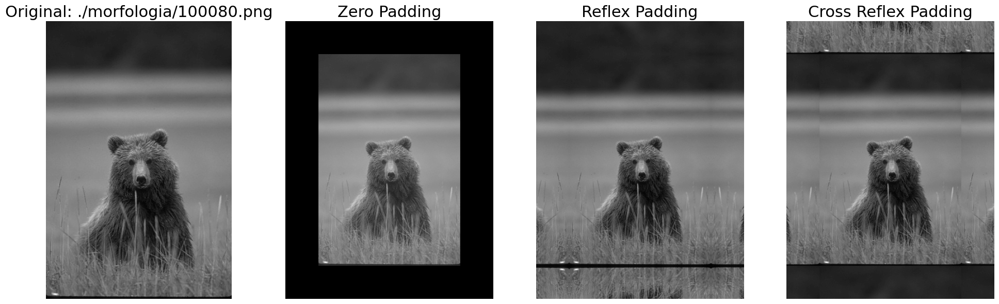

In [47]:
showPadding('./morfologia/100080.png', 151)

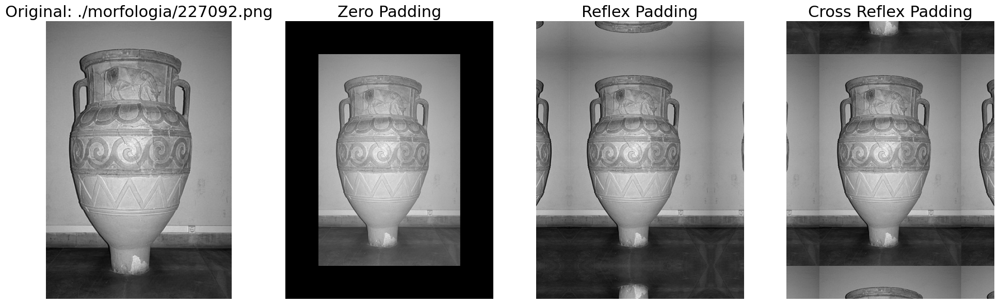

In [19]:
showPadding('./morfologia/227092.png', 151)

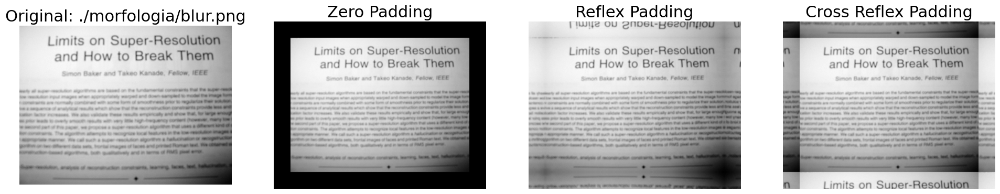

In [20]:
showPadding('./morfologia/blur.png', 151)

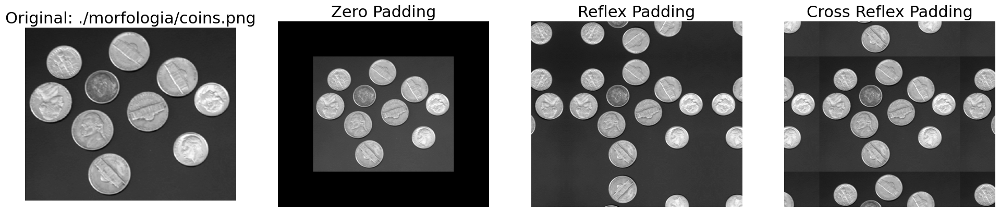

In [21]:
showPadding('./morfologia/coins.png', 151)

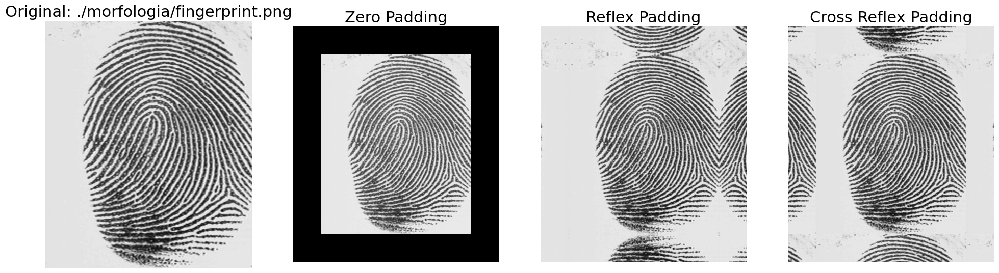

In [22]:
showPadding('./morfologia/fingerprint.png', 151)

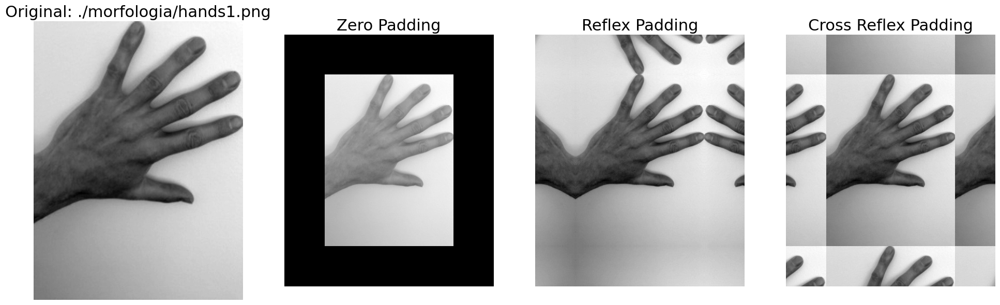

In [23]:
showPadding('./morfologia/hands1.png', 151)

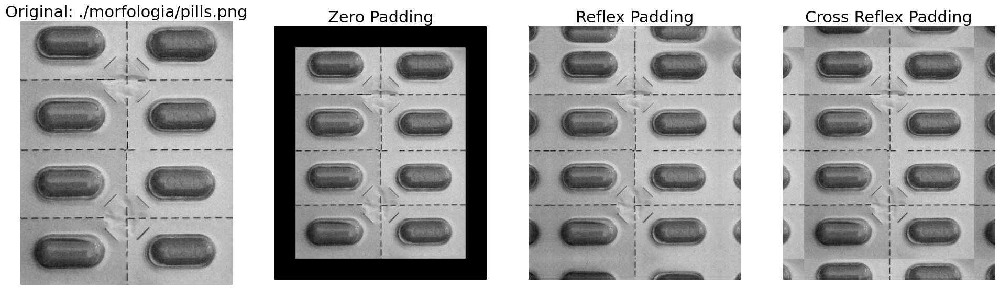

In [24]:
showPadding('./morfologia/pills.png', 151)

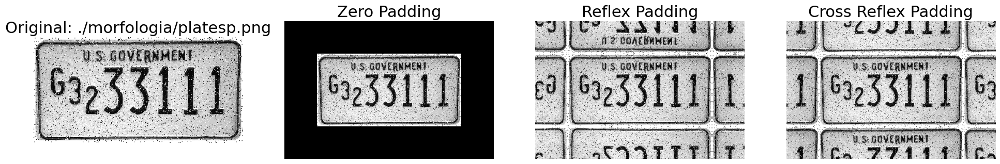

In [25]:
showPadding('./morfologia/platesp.png', 151)

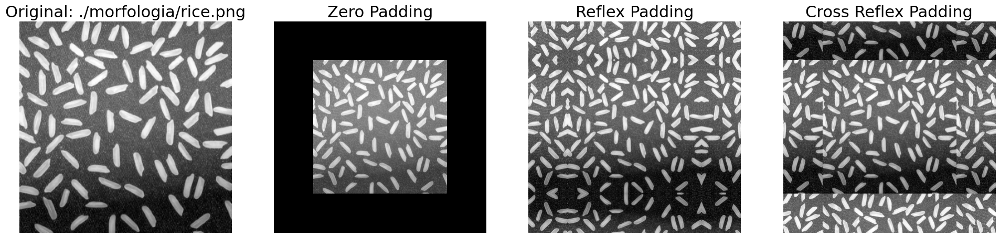

In [26]:
showPadding('./morfologia/rice.png', 151)

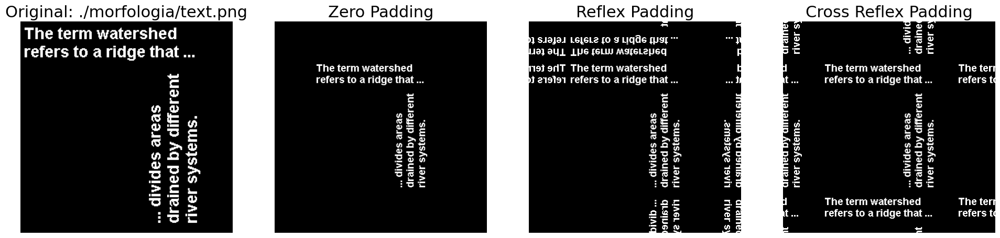

In [27]:
showPadding('./morfologia/text.png', 151)

# **3. Morfología matemática**

# **3. 1. Código**

In [48]:
class Morphological_operator:
    def __init__(self, image, structural_element, padding_operator):
        
        self.image = image
        
        self.mask_size = structural_element[0].shape[0]
        
        self.structural_element = structural_element
        
        self.padding = padding_operator
        
    def dilatation(self,):
        try:
            # all are odd in mask
            if self.mask_size % 2 == 0:
                raise ValueError('The size of the mask must be odd.')
                raise Exception('This is the exception you expect to handle.')

            # binary tensor
            if self.image.ndim != 2:
                raise ValueError('The image must be two-dimensional')
                raise Exception('This is the exception you expect to handle.')
           

            #compute the size of padding for mask processing 

            pad_size = self.mask_size // 2 

            # add padding on imagen

            padded = self.padding(self.image, self.structural_element[0])
           
            #output image
            new_image = np.copy(self.image)
            padded_new_image = self.padding(new_image, self.structural_element[0])
            
            
            for i in range(self.image.shape[0]):
                for j in range(self.image.shape[1]):

                    # mask centered on current pixel
                    mapped = padded[i : i + self.mask_size, j : j + self.mask_size]
                    
                    #mask  centered on current pixel of output image
                    fill = padded_new_image[i : i + self.mask_size, j : j + self.mask_size]
                    
                    if mapped[self.structural_element[1], self.structural_element[1]] == 1:
                        rows , columns = np.where(self.structural_element[0] == 1)
                        fill[rows , columns] = 1
            for i in range(pad_size):
                padded_new_image = padded_new_image[1:-1, 1:-1]
                        
                       
        except Exception as error:
            print('Caught this error: ' + repr(error))
        else: 
            return padded_new_image
    
    def erosion(self,):
        try:
            # all are odd in mask
            if self.mask_size % 2 == 0:
                raise ValueError('The size of the mask must be odd.')
                raise Exception('This is the exception you expect to handle.')

            # binary tensor
            if self.image.ndim != 2:
                raise ValueError('The image must be two-dimensional')
                raise Exception('This is the exception you expect to handle.')
           

            #compute the size of padding for mask processing 

            pad_size = self.mask_size // 2 

            # add padding on imagen

            padded = self.padding(self.image, self.structural_element[0])
           
            #output image
            new_image = np.copy(self.image)
            padded_new_image = self.padding(new_image, self.structural_element[0])
            
            
            for i in range(self.image.shape[0]):
                for j in range(self.image.shape[1]):

                    # mask centered on current pixel
                    mapped = padded[i : i + self.mask_size, j : j + self.mask_size]
                    
                    #mask  centered on current pixel of output image
                    fill = padded_new_image[i : i + self.mask_size, j : j + self.mask_size]
                              
                    if  not(np.array_equal(
                        np.logical_and(mapped, self.structural_element[0]), 
                        self.structural_element[0])):
                        fill[self.structural_element[1], self.structural_element[1]] = 0

            for i in range(pad_size):
                padded_new_image = padded_new_image[1:-1, 1:-1]
        except Exception as error:
            print('Caught this error: ' + repr(error))
        else: 
            return padded_new_image
        

    def opening(self,):
        img_temporal =self.erosion()
        return Morphological_operator(img_temporal,self.structural_element,self.padding).dilatation()
    
    def closure(self,):
        img_temporal = self.dilatation()
        return Morphological_operator(img_temporal,self.structural_element,self.padding).erosion()
    
    def binary_perimeter(self,): #check
        x = np.copy(self.image) 
        x = Morphological_operator(x,self.structural_element,self.padding).erosion()
        return self.image - x
    
    def binary_skeleton(self):  #not check
        img = self.image.copy()
        skeleton = np.zeros(self.image.shape,np.uint8)
        
        while True:
            opened = Morphological_operator(img,self.structural_element,self.padding).opening()
            subtraction = np.subtract(img , opened)
            eroded = Morphological_operator(img,self.structural_element,self.padding).erosion()
            skeleton = np.bitwise_or(skeleton.astype(np.int32),subtraction.astype(np.int32))
            img = eroded.copy()
            
            if np.count_nonzero(img) == 0:
                break
      
        return skeleton
        
    def remove_binary_noise(self,):
        x = np.copy(self.image)
        x = Morphological_operator(x, self.structural_element, self.padding).opening()
        x = Morphological_operator(x, self.structural_element, self.padding).closure()
        return x
    
    def __call__(self, typeOperation):
            if typeOperation == 'dilatation':
                return self.dilatation()
            if typeOperation == 'erosion':
                return self.erosion()
            if typeOperation == 'opening':
                return self.opening()
            if typeOperation == 'closure':
                return self.closure()
        

    
    

# **3. 2. Prueba**

In [49]:
def show_morphological_operations(pathImage, threshold, structural_element, padding_operator):
    
    #read image with gray scale
    
    grayImage = readGrayscaleimage(pathImage)
    grayImage = np.asarray(grayImage)
    extension = '.png'
    
    if pathImage.find('.jpg') != -1:
         extension = '.jpg'
    if pathImage.find('.png') != -1:
         extension = '.png'
     
    plt.figure(figsize=(24,7)) # size of image
            
    #original image
    plt.subplot(1,6,1)
    plt.imshow(grayImage, cmap= plt.cm.gray)
    plt.title(f'Original: {pathImage}', fontsize=22)
    plt.axis('off')
    
    
    #Binary image
    copy1 = np.copy(grayImage) #QA
    G = np.where(copy1 > threshold, 1, 0) #return binary array
    G = np.uint8(G)
    G = G * 255
    plt.subplot(1,6,2)
    plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
    plt.title('Binary', fontsize=22)
    plt.axis('off')
    
    
    #Dilatation
    copy2 = np.copy(grayImage) #QA
    G = np.where(copy2 > threshold, 1, 0) #return binary array
    G = np.uint8(G)
    G = Morphological_operator(G, structural_element, padding_operator).dilatation()
    G = G * 255
    plt.subplot(1,6,3)
    plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
    plt.title('Dilatation', fontsize=22)
    plt.axis('off')
    
    
    #Erosion
    copy3 = np.copy(grayImage) #QA
    G = np.where(copy3 > threshold, 1, 0) #return binary array
    G = np.uint8(G)
    G = Morphological_operator(G, structural_element, padding_operator).erosion()
    G = G * 255
    plt.subplot(1,6,4)
    plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
    plt.title('Erosion', fontsize=22)
    plt.axis('off')
    
    
    #Opening
    copy4 = np.copy(grayImage) #QA
    G = np.where(copy4 > threshold, 1, 0) #return binary array
    G = np.uint8(G)
    G = Morphological_operator(G, structural_element, padding_operator).opening()
    G = G * 255
    plt.subplot(1,6,5)
    plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
    plt.title('Opening', fontsize=22)
    plt.axis('off')
    
    
    #Closure
    copy5 = np.copy(grayImage) #QA
    G = np.where(copy5 > threshold, 1, 0) #return binary array
    G = np.uint8(G)
    G = Morphological_operator(G, structural_element, padding_operator).closure()
    G = G * 255
    plt.subplot(1,6,6)
    plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
    plt.title('Closure', fontsize=22)
    plt.axis('off')
    
    


In [30]:
def show_morphological_operations_image(image,pathImage, threshold, structural_element, padding_operator):
    
    #read image with gray scale
    
    grayImage = image
    grayImage = np.asarray(grayImage)
   
     
    plt.figure(figsize=(24,7)) # size of image
            
    #original image
    plt.subplot(1,6,1)
    plt.imshow(grayImage, cmap= plt.cm.gray)
    plt.title(f'Original: {pathImage}', fontsize=22)
    plt.axis('off')
    
    
    #Binary image
    copy1 = np.copy(grayImage) #QA
    G = np.where(copy1 > threshold, 1, 0) #return binary array
    G = np.uint8(G)
    G = G * 255
    plt.subplot(1,6,2)
    plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
    plt.title('Binary', fontsize=22)
    plt.axis('off')
    
    
    #Dilatation
    copy2 = np.copy(grayImage) #QA
    G = np.where(copy2 > threshold, 1, 0) #return binary array
    G = np.uint8(G)
    G = Morphological_operator(G, structural_element, padding_operator).dilatation()
    G = G * 255
    plt.subplot(1,6,3)
    plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
    plt.title('Dilatation', fontsize=22)
    plt.axis('off')
    
    
    #Erosion
    copy3 = np.copy(grayImage) #QA
    G = np.where(copy3 > threshold, 1, 0) #return binary array
    G = np.uint8(G)
    G = Morphological_operator(G, structural_element, padding_operator).erosion()
    G = G * 255
    plt.subplot(1,6,4)
    plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
    plt.title('Erosion', fontsize=22)
    plt.axis('off')
    
    
    #Opening
    copy4 = np.copy(grayImage) #QA
    G = np.where(copy4 > threshold, 1, 0) #return binary array
    G = np.uint8(G)
    G = Morphological_operator(G, structural_element, padding_operator).opening()
    G = G * 255
    plt.subplot(1,6,5)
    plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
    plt.title('Opening', fontsize=22)
    plt.axis('off')
    
    
    #Closure
    copy5 = np.copy(grayImage) #QA
    G = np.where(copy5 > threshold, 1, 0) #return binary array
    G = np.uint8(G)
    G = Morphological_operator(G, structural_element, padding_operator).closure()
    G = G * 255
    plt.subplot(1,6,6)
    plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
    plt.title('Closue', fontsize=22)
    plt.axis('off')

In [52]:
def ComparisonGlobalBinarizations(pathImage):
    #read image with gray scale
    grayImage = readGrayscaleimage(pathImage)
    grayImage = np.asarray(grayImage)
    
    plt.figure(figsize=(24,7)) # size of image        
    #original image
    plt.subplot(1,7,1)
    plt.imshow(grayImage, cmap= plt.cm.gray)
    plt.title(f'{pathImage}', fontsize=22)
    plt.axis('off')

    
    
    #Outsu
    #execute function
    threshold = threshold_otsu(grayImage)
    #binarize
    G = np.where(grayImage > threshold, 255, 0)
    #show image
    plt.subplot(1,7,2)
    plt.imshow(G, cmap= plt.cm.gray)
    plt.title('Otsu', fontsize=22)
    plt.ylabel(f'threshold={int(threshold)}',fontdict = {'fontsize':14, 'fontweight':'bold', 'color':'tab:blue'})
    plt.axis('off')

    
    
    # Kapur
    #execute function
    threshold = kapur_threshold(grayImage)
    #binarize
    G = np.where(grayImage > threshold, 255, 0)
    #show image
    plt.subplot(1,7,3)
    plt.imshow(G, cmap= plt.cm.gray)
    plt.title('Kapur', fontsize=22)
    plt.ylabel(f'threshold={int(threshold)}',fontdict = {'fontsize':14, 'fontweight':'bold', 'color':'tab:blue'})
    #plt.axis('off')

    
    
    # Isodata
    #execute function
    threshold = threshold_isodata(grayImage)
    #binarize
    G = np.where(grayImage > threshold, 255, 0)
    #show image
    plt.subplot(1,7,4)
    plt.imshow(G, cmap= plt.cm.gray)
    plt.title('Isodata', fontsize=22)
    plt.ylabel(f'threshold={int(threshold)}',fontdict = {'fontsize':14, 'fontweight':'bold', 'color':'tab:blue'})
    #plt.axis('off')
    
    
    #Niblack
    #execute function
    threshold = threshold_niblack(grayImage, 1023, k=0.5)
    #binarize
    G = grayImage > threshold
    #show image
    plt.subplot(1,7,5)
    plt.imshow(G, cmap= plt.cm.gray)
    plt.title('niblack', fontsize=22)
    plt.xlabel(f'mask={1023}',fontdict = {'fontsize':14, 'fontweight':'bold', 'color':'tab:blue'})
    #plt.axis('off')
    
    #start timer
    #execute function
    threshold = threshold_sauvola(grayImage, 1023, k=0.2)
    #binarize
    G = grayImage > threshold

    plt.subplot(1,7,6)
    plt.imshow(G, cmap= plt.cm.gray)
    plt.title('Sauvola', fontsize=22)
    plt.xlabel(f'mask={1023}',fontdict = {'fontsize':14, 'fontweight':'bold', 'color':'tab:blue'})
    #plt.axis('off')
    
    #Bernsen
    #execute function
    binaryImage = np.empty(grayImage.shape,grayImage.dtype)
    bernsen = doxapy.Binarization(doxapy.Binarization.Algorithms.BERNSEN)
    bernsen.initialize(grayImage)
    bernsen.to_binary(binaryImage, {"window":265, "k": 0.8})
    bernsen = img_as_ubyte(binaryImage)
    #show image
    plt.subplot(1,7,7)
    plt.imshow(bernsen, cmap= plt.cm.gray)
    plt.title('Bernsen', fontsize=22)
    plt.xlabel(f'mask={265}',fontdict = {'fontsize':18, 'fontweight':'bold', 'color':'tab:blue'})
    #plt.axis('off')
    plt.subplots_adjust(
        left=0.125,              
        bottom=0.1, 
        right=0.9, 
        top=0.9, 
        wspace=0.2, 
        hspace=0.35)



## **3.2.1. Oso**

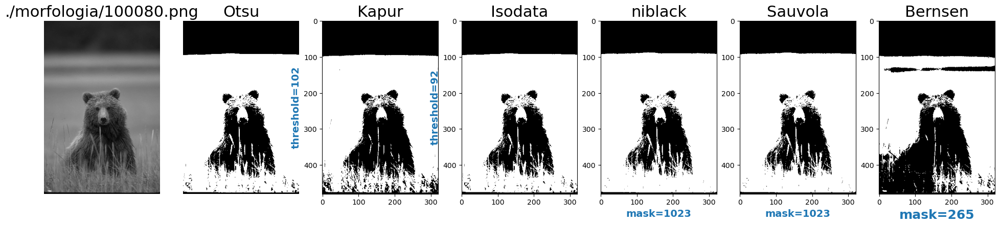

In [53]:
ComparisonGlobalBinarizations('./morfologia/100080.png')

**Análisis**

Se está comparando todos los métodos de binarización y se observa que el método de Kapur conserva mejor el cuerpo y separa el fondo del cuerpo del oso.

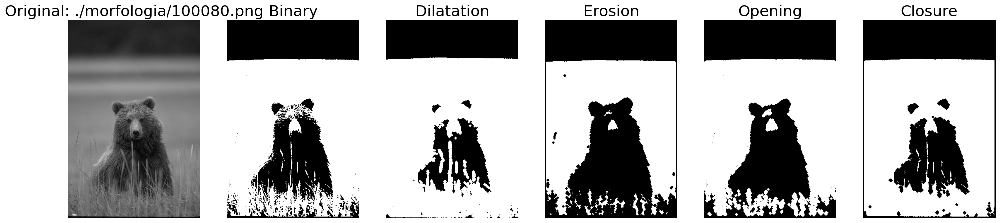

In [54]:
image =  readGrayscaleimage('./morfologia/100080.png')
threshold = kapur_threshold(image)
show_morphological_operations('./morfologia/100080.png', threshold, Structural_element.diamond(size=7), Padding.zero_padding)

## **3.2.2. Jarrón**

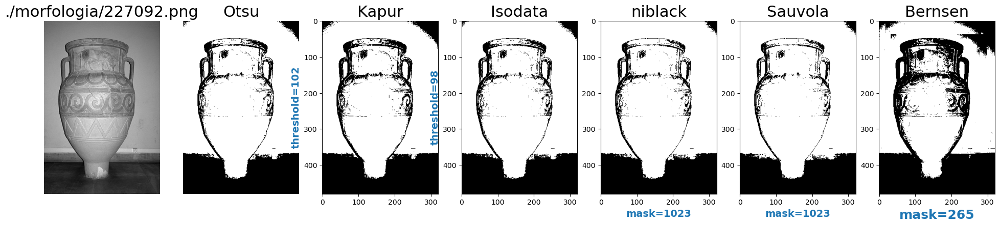

In [55]:
ComparisonGlobalBinarizations('./morfologia/227092.png')

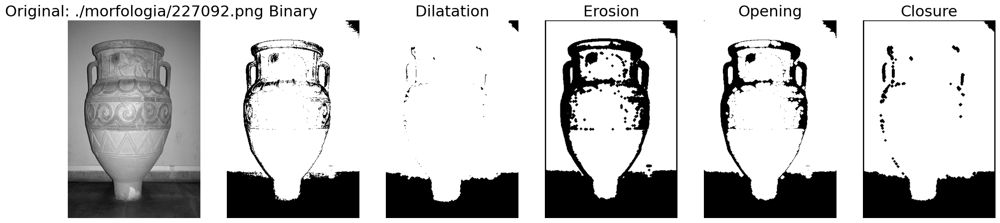

In [66]:
image =  readGrayscaleimage('./morfologia/227092.png')
threshold = threshold_niblack(image, 1023, k=0.5)
show_morphological_operations('./morfologia/227092.png', threshold, Structural_element.diamond(size=7), Padding.zero_padding)


**Análisis**

Se utulizó niblack con máscara 1023 debido a que este separa el fondo del jarró y define bien la figura eliminando detalles.

## **3.2.3. Texto**

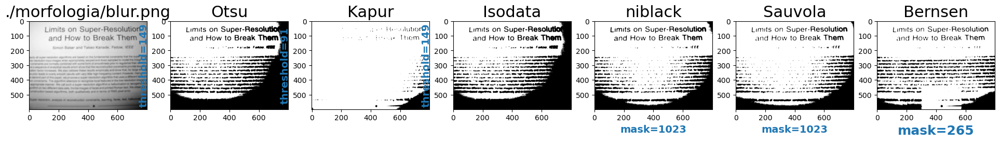

In [36]:
ComparisonGlobalBinarizations('./morfologia/blur.png')

**Análisis**

Se está aplicando todas las operaciones de la morfología matemática binaria para la imagen de las letras.

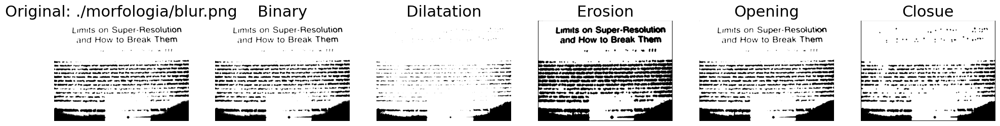

In [76]:
grayImage =  readGrayscaleimage('./morfologia/blur.png')
binaryImage = np.empty(grayImage.shape,grayImage.dtype)
bernsen = doxapy.Binarization(doxapy.Binarization.Algorithms.BERNSEN)
bernsen.initialize(grayImage)
bernsen.to_binary(binaryImage, {"window":265, "k": 0.8})
bernsen = img_as_ubyte(binaryImage)
show_morphological_operations_image(bernsen,'./morfologia/blur.png', threshold, Structural_element.diamond(size=7), Padding.zero_padding)


## **3.2.4. Monedas**

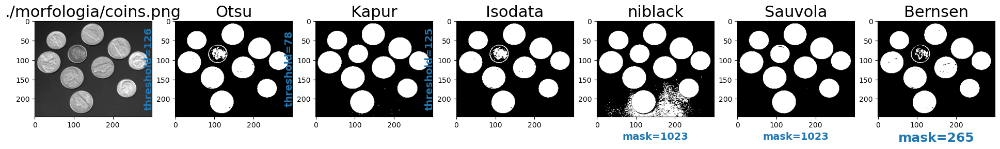

In [77]:
ComparisonGlobalBinarizations('./morfologia/coins.png')

**Análisis**

Se utilizó Kapur con umbral 126 pues este define mejor la segmentación conservando toda la circunsferencias.

78


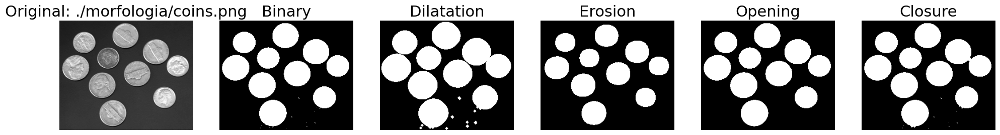

In [78]:
image =  readGrayscaleimage('./morfologia/coins.png')
threshold = kapur_threshold(image)
show_morphological_operations('./morfologia/coins.png', threshold, Structural_element.diamond(size=7), Padding.zero_padding)
print(threshold)

## **3.2.5. Huella**

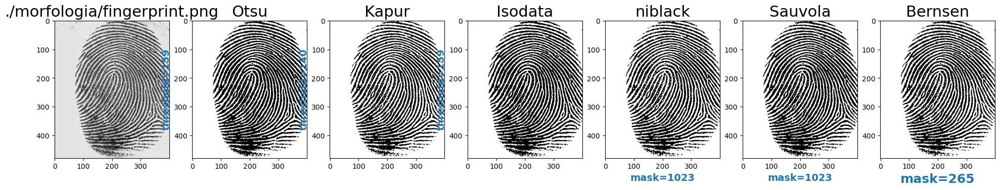

In [43]:
ComparisonGlobalBinarizations('./morfologia/fingerprint.png')

**Análisis**

Se aplicó el método Isodata porque posee una mejor segmentación al reducir más las sombras.

159


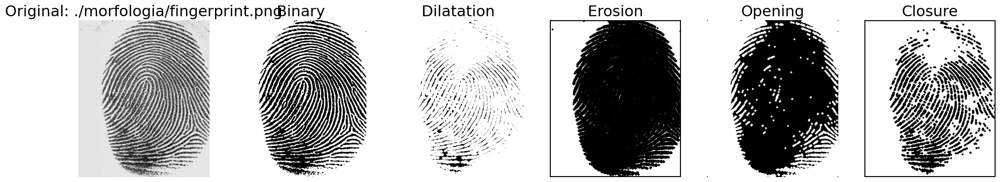

In [79]:
image =  readGrayscaleimage('./morfologia/fingerprint.png')
threshold = threshold_isodata(image)
show_morphological_operations('./morfologia/fingerprint.png', threshold, Structural_element.diamond(size=7), Padding.zero_padding)
print(threshold)

## **3.2.6. Mano**

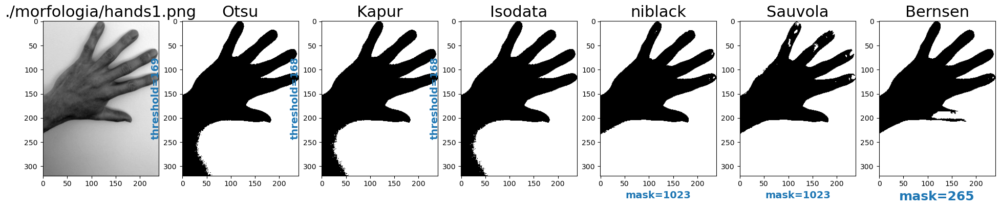

In [80]:
ComparisonGlobalBinarizations('./morfologia/hands1.png')

**Análisis**

 El mejor método de binarización para este caso es el niblack.

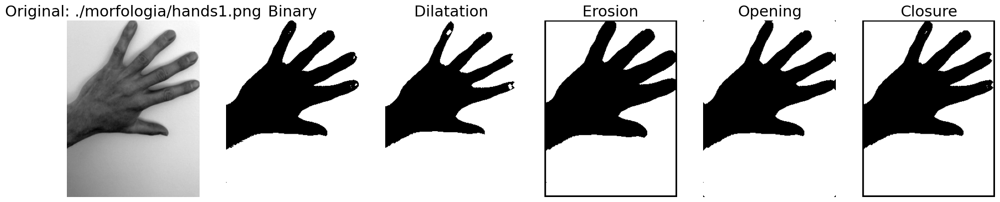

In [81]:
image =  readGrayscaleimage('./morfologia/hands1.png')
threshold = threshold_niblack(image, 1023, k=0.5)
show_morphological_operations('./morfologia/hands1.png', threshold, Structural_element.diamond(size=7), Padding.zero_padding)

## **3.2.7. Píldoras** 

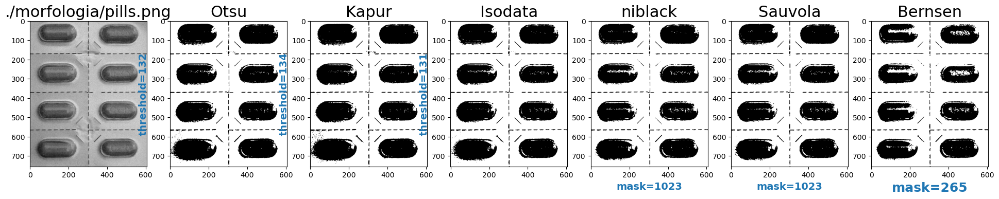

In [49]:
ComparisonGlobalBinarizations('./morfologia/pills.png')

**Análisis**

Se está aplicando el umbral de isodata pues posee menos brillo.

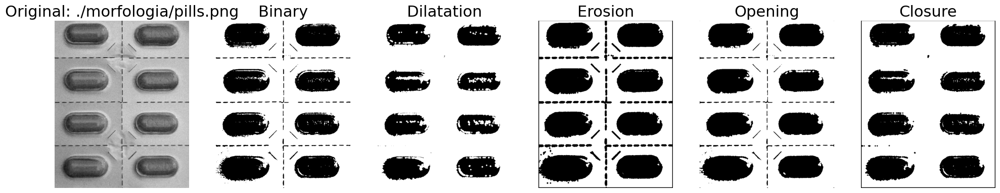

In [83]:
image =  readGrayscaleimage('./morfologia/pills.png')
threshold = threshold_isodata(image)
show_morphological_operations('./morfologia/pills.png', threshold, Structural_element.diamond(size=7), Padding.zero_padding)


## **3.2.8. Arroz** 

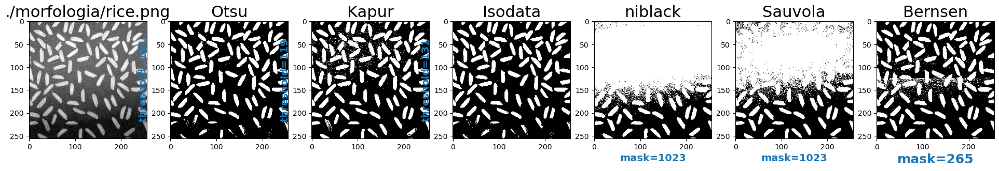

In [52]:
ComparisonGlobalBinarizations('./morfologia/rice.png')

**Análisis**

Se aplicó el umbral de Isodata porque posee menos ruido y mantinen mejor la forma del arroz.

131


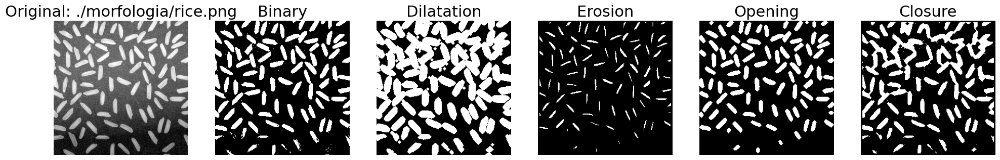

In [84]:
image =  readGrayscaleimage('./morfologia/rice.png')
threshold = threshold_isodata(image)
show_morphological_operations('./morfologia/rice.png', threshold, Structural_element.diamond(size=7), Padding.zero_padding)
print(threshold)

**Análisis**
Se está aplicando todas las operaciones de la morfología matemática binaria. Se considera el méjor metodo el de clausura.

## **3.2.9. Placa** 

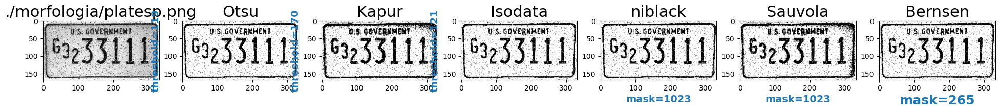

In [56]:
ComparisonGlobalBinarizations('./morfologia/platesp.png')

**Análisis**

Se aplicó el umbral de Otsu porque segmenta mejor con menos ruido y mantiene la forma de los números.

119


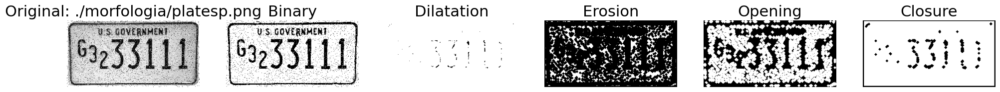

In [85]:
image =  readGrayscaleimage('./morfologia/platesp.png')
threshold = threshold_otsu(image)
show_morphological_operations('./morfologia/platesp.png', threshold, Structural_element.diamond(size=7), Padding.zero_padding)
print(threshold)

## **3.2.10. Letras** 

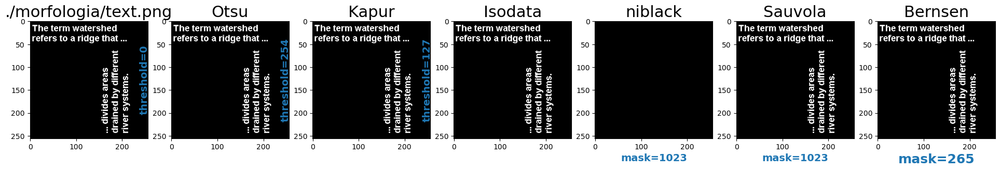

In [59]:
ComparisonGlobalBinarizations('./morfologia/text.png')

**Análisis**

Se aplicó el umbral de Isodata porque binariza mejor el fondo con las letras.

127


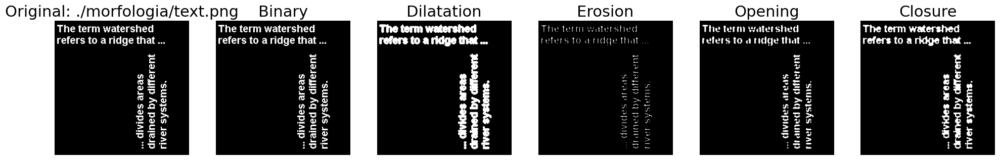

In [69]:
image =  readGrayscaleimage('./morfologia/text.png')
threshold = threshold_isodata(image)
show_morphological_operations('./morfologia/text.png', threshold, Structural_element.diamond(size=3), Padding.zero_padding)
print(threshold)

# **4. Perimetro, Esqueleto y eliminar Ruido**

In [62]:
def show_perimeter_and_noise(pathImage, threshold, structural_element, padding_operator,body=True):
    if body:
        #read image with gray scale

        grayImage = readGrayscaleimage(pathImage)
        grayImage = np.asarray(grayImage)
        extension = '.png'

        if pathImage.find('.jpg') != -1:
             extension = '.jpg'
        if pathImage.find('.png') != -1:
             extension = '.png'

        plt.figure(figsize=(24,7)) # size of image

        #original image
        plt.subplot(1, 6, 1)
        plt.imshow(grayImage, cmap= plt.cm.gray)
        plt.title(f'{pathImage}', fontsize=22)
        plt.axis('off')


        #Binary image
        copy1 = np.copy(grayImage) #QA
        G = np.where(copy1 > threshold, 1, 0) #return binary array
        G = np.uint8(G)
        G = G * 255
        plt.subplot(1, 6, 2)
        plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
        plt.title('Binary', fontsize=22)
        plt.axis('off')


        #Perimeter
        copy2 = np.copy(grayImage) #QA
        G = np.where(copy2 > threshold, 1, 0) #return binary array
        G = np.uint8(G)
        G = Morphological_operator(G, structural_element, padding_operator).binary_perimeter()
        G = G * 255
        plt.subplot(1, 6, 3)
        plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
        plt.title('Perimeter', fontsize=22)
        plt.axis('off')


        #Noise
        copy3 = np.copy(grayImage) #QA
        G = np.where(copy3 > threshold, 1, 0) #return binary array
        G = np.uint8(G)
        G = Morphological_operator(G, structural_element, padding_operator).remove_binary_noise()
        G = G * 255
        plt.subplot(1, 6,4)
        plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
        plt.title('Noise', fontsize=22)
        plt.axis('off')


        #Perimeter without Noise
        copy3 = np.copy(grayImage) #QA
        G = np.where(copy3 > threshold, 1, 0) #return binary array
        G = np.uint8(G)
        G = Morphological_operator(G, structural_element, padding_operator).remove_binary_noise()
        G = Morphological_operator(G, structural_element, padding_operator).binary_perimeter()
        G = G * 255
        plt.subplot(1 ,6 ,5)
        plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
        plt.title('Perimeter without Noise', fontsize=22)
        plt.axis('off')


        #Skeleton
        copy3 = np.copy(grayImage) #QA
        G = np.where(copy3 > threshold, 1, 0) #return binary array
        G = np.uint8(G)
        G = Morphological_operator(G, structural_element, padding_operator).remove_binary_noise()
        G = Morphological_operator(G, structural_element, padding_operator).binary_skeleton()
        G = G * 255
        plt.subplot(1 ,6 ,6)
        plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
        plt.title('Skeleton', fontsize=22)
        plt.axis('off')
    else:
        #read image with gray scale

        grayImage = readGrayscaleimage(pathImage)
        grayImage = np.asarray(grayImage)
        extension = '.png'

        if pathImage.find('.jpg') != -1:
             extension = '.jpg'
        if pathImage.find('.png') != -1:
             extension = '.png'

        plt.figure(figsize=(24,7)) # size of image

        #original image
        plt.subplot(1, 6, 1)
        plt.imshow(grayImage, cmap= plt.cm.gray)
        plt.title(f'{pathImage}', fontsize=22)
        plt.axis('off')


        #Binary image
        copy1 = np.copy(grayImage) #QA
        G = np.where(copy1 < threshold, 1, 0) #return binary array
        G = np.uint8(G)
        G = G * 255
        plt.subplot(1, 6, 2)
        plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
        plt.title('Binary', fontsize=22)
        plt.axis('off')


        #Perimeter
        copy2 = np.copy(grayImage) #QA
        G = np.where(copy2 < threshold, 1, 0) #return binary array
        G = np.uint8(G)
        G = Morphological_operator(G, structural_element, padding_operator).binary_perimeter()
        G = G * 255
        plt.subplot(1, 6, 3)
        plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
        plt.title('Perimeter', fontsize=22)
        plt.axis('off')


        #Noise
        copy3 = np.copy(grayImage) #QA
        G = np.where(copy3 < threshold, 1, 0) #return binary array
        G = np.uint8(G)
        G = Morphological_operator(G, structural_element, padding_operator).remove_binary_noise()
        G = G * 255
        plt.subplot(1, 6,4)
        plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
        plt.title('Noise', fontsize=22)
        plt.axis('off')


        #Perimeter without Noise
        copy3 = np.copy(grayImage) #QA
        G = np.where(copy3 < threshold, 1, 0) #return binary array
        G = np.uint8(G)
        G = Morphological_operator(G, structural_element, padding_operator).remove_binary_noise()
        G = Morphological_operator(G, structural_element, padding_operator).binary_perimeter()
        G = G * 255
        plt.subplot(1 ,6 ,5)
        plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
        plt.title('Perimeter without Noise', fontsize=22)
        plt.axis('off')


        #Skeleton
        copy3 = np.copy(grayImage) #QA
        G = np.where(copy3 < threshold, 1, 0) #return binary array
        G = np.uint8(G)
        G = Morphological_operator(G, structural_element, padding_operator).remove_binary_noise()
        G = Morphological_operator(G, structural_element, padding_operator).binary_skeleton()
        G = G * 255
        plt.subplot(1 ,6 ,6)
        plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
        plt.title('Skeleton', fontsize=22)
        plt.axis('off')
    
   

t =  92


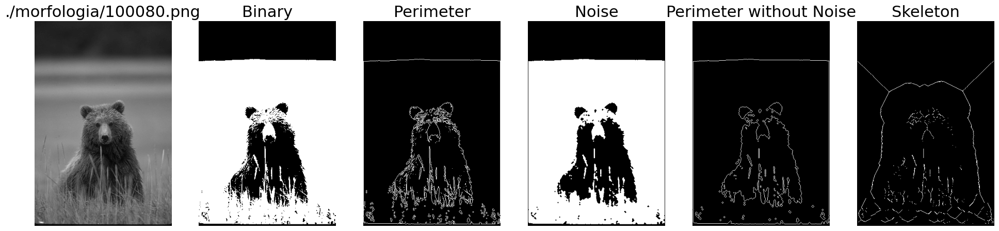

In [100]:
image =  readGrayscaleimage('./morfologia/100080.png')
threshold = kapur_threshold(image)
show_perimeter_and_noise('./morfologia/100080.png', threshold, Structural_element.diamond(size=3), Padding.zero_padding,True)
print('t = ',threshold)

**Análisis oso**

Se utilizó Isodata con umbral 92 pues este segmentaba mejor que el resto de algoritmos. Se observa que el perímetro delimita el cuerpo del oso y de las hojas. Eliminando el ruido el contorno arregla algunos problemas de las hojas pero elimina el perimetro de la cabeza. El esqueleto de la imagen al poseer muchas sombras y pelos no se define bien. Se utilizó padding zero y el elemnto estructural diamante de tamaño 3 para adecuarse al pelaje del oso.

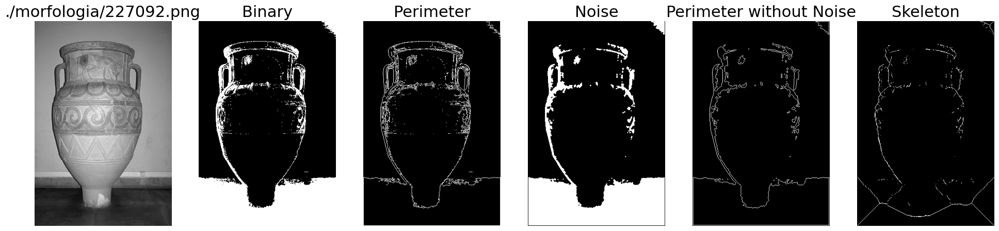

In [67]:
image =  readGrayscaleimage('./morfologia/227092.png')
threshold = threshold_niblack(image, 1023, k=0.5)
show_perimeter_and_noise('./morfologia/227092.png', threshold, Structural_element.diamond(size=3), Padding.zero_padding,False)

**Análisis Jarrón**

Se utilizó Niblack con mascara 1023 pues este segmentaba mejor que el resto de algoritmos. Se observa que el perímetro está bien delimitado pero al poseer el jarrón relieves también se hacen presentes. Al aplicar el algoritmo de eliminación de ruido (Apertura seguida de una Erosion), estos relieves se eliminan dejando una mejor apreciación del contorno pero algunas partes se eliminan al ser muy delgadas. El esqueleto si  se forma de acuerdo a la imagen. Se utilizó elemento estructural diamante con tamaño 3 para adecuarse a los bordes del jarrón  y padding cero.

t =  149


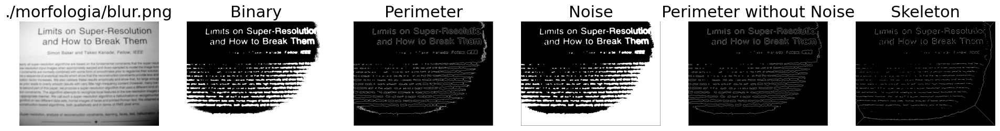

In [108]:
image =  readGrayscaleimage('./morfologia/blur.png')
threshold = threshold_isodata(image)
show_perimeter_and_noise('./morfologia/blur.png', threshold, Structural_element.diamond(size=3), Padding.zero_padding, False)
print('t = ',threshold)

**Análisis Texto**

Se utilizó el umbral 149 de Isodata. La imagen delimita muy bien el contorno de las letras del título. Si eliminamos ruido esto se pierde puesto que las letras son muy delgadas. El esqueleto reduce muy bien el ancho de las letras a un pixel. Se usó el elemento estructural diamante de tamaño 3 puesto que las letras eran delgadas y padding cero.

t =  78


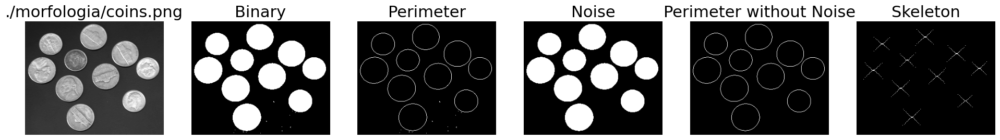

In [13]:
image =  readGrayscaleimage('./morfologia/coins.png')
threshold = kapur_threshold(image)
show_perimeter_and_noise('./morfologia/coins.png', threshold, Structural_element.diamond(size=3), Padding.zero_padding)
print('t = ',threshold)

**Análisis Monedas**

El umbral 78 de Kapur disminuyó el ruido y ayudó a formar el contorno de acuerdo a la simetría de las monedas,. Utilizando el algoritmo de eliminación de ruido nos muestra sólo el contorno y si aplicamos el algoritmo del esqueleto se muestran las X que son de esa forma porque el cuerpo es una circunsferencia. El elemento estructural usado fue diamante con tamaño de 3 para conservar el borde con meyor presición y padding cero.

t =  159


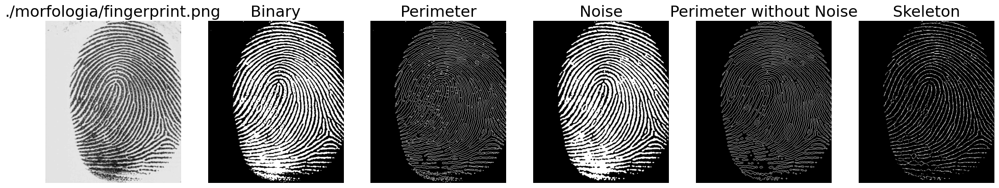

In [102]:
image =  readGrayscaleimage('./morfologia/fingerprint.png')
threshold = threshold_isodata(image)
show_perimeter_and_noise('./morfologia/fingerprint.png', threshold, Structural_element.diamond(size=3), Padding.zero_padding,False)
print('t = ',threshold)

**Análisis Huella**

Se aplicó umbral de isodata pues este tenía meno sombras en la huella. Además ayudó a conseguir el perimetro del las lineas de las huellas y su esqueleto. Si bien mostramos como se vería si quitamos ruido, este último no favorece a la imágen pues elimina líneas delgadas. El ser las líneas delgadas se utilizó el elemento estructural diamante con cero padding.

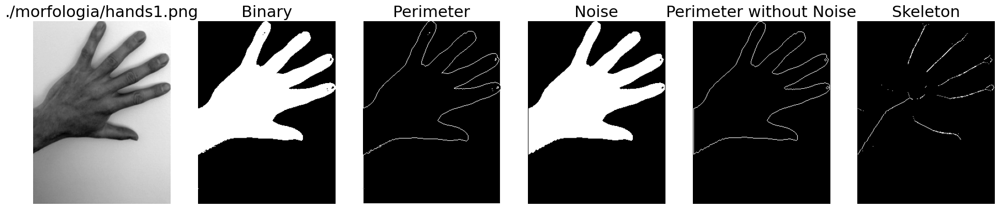

In [94]:
image =  readGrayscaleimage('./morfologia/hands1.png')
threshold = threshold_niblack(image, 1023, k=0.5)
show_perimeter_and_noise('./morfologia/hands1.png', threshold, Structural_element.diamond(size=3), Padding.zero_padding,False)

**Análisis Mano**

El algoritmo local de Niblack ayudó a binarizar la imagen con mejor forma además que eliminó la sombra de la mano. Luego esto ayudó a definir el contorno correctamente utiliando la resta de la imagen binaria con erosión, aunque se observan algunos ruidos de color negro. Esto se eliminó con el algoritmo de ruido definiendo un contorno limpio. También ayudó a formar el esqueleto de un pixel de ancho donde se aprecia la muñeca, la mano y los dedos. El elemento estructural usado fue diamante de tamaño 3 con padding cero.

t =  131


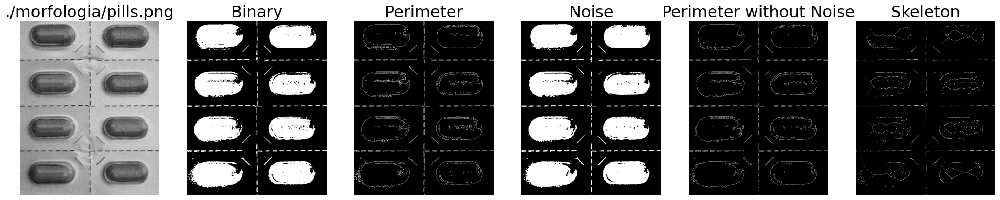

In [106]:
image =  readGrayscaleimage('./morfologia/pills.png')
threshold = threshold_isodata(image)
show_perimeter_and_noise('./morfologia/pills.png', threshold, Structural_element.diamond(size=3), Padding.zero_padding, False)
print('t = ',threshold)

**Análisis Píldoras**

En esta imagen el método de Isodata con umbral 131 segmentó la imagen evitando la alta presencia de brillo del plástico de las píldoras. El resto de brillo se puede eliminar aplicando el algoritmo de ruido (Apertura - Clausura). Luego,  el contorno de esta imagen con ruido reducido define bien las píldoras. También muestra el esqueleto de las píldoras a un grosor de un pixel. Se elemento estructural diamante con tamaño 3 y padding cero.

t =  119


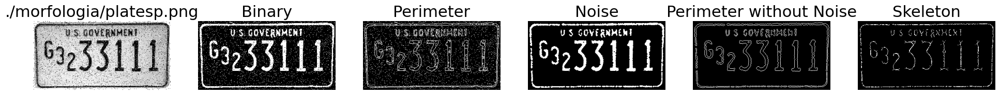

In [68]:
image =  readGrayscaleimage('./morfologia/platesp.png')
threshold = threshold_otsu(image)
show_perimeter_and_noise('./morfologia/platesp.png', threshold, Structural_element.diamond(size=3), Padding.zero_padding,False)
print('t = ',threshold)

**Análisis Placa**

Se aplicó umbral 110 de Otsu porque conservaba la imagen con menos ruido posible y sombras. Luego, se aplicó la reducción del ruido sal y pimienta con una apertura y una clausura, esto permitó formar el contorno y el esqueleto sin ruidos. Los contornos de la imagen conservan la simetrpia de los números y el esqueleto conserva la forma del número a tamaño de un píxel. El kernel usado fue diamante de tamaño 3 debido a que se quiere reducir el cuerpo de los números hasta un pixel con mayor presición. Se utilizó cero padding debido a que no estamos en escalas de grises y el vecindario en los bordes no afecta significativamente. 

t =  131


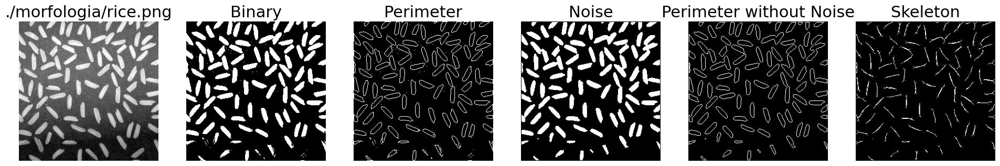

In [104]:
image =  readGrayscaleimage('./morfologia/rice.png')
threshold = threshold_isodata(image)
show_perimeter_and_noise('./morfologia/rice.png', threshold, Structural_element.diamond(size=3), Padding.zero_padding)
print('t = ',threshold)

**Análisis Arroz**

Primero binarizamos la imagen con el umbral 131 del algoritmo isodata pues tiene menos ruido y conserva mejor la forma del arroz. Aquí tambien, se eliminó el ruido sal y pimienta aunque hubo más presencia de píxeles de color blanco. Esto Resaltó más el segundo plano oscureciendo la imágen en su totalidad y resaltando las formas del arroz. El contorno quedó bien definido y el esqueleto tomo forma de huesitos porque la forma del arroz es de un diamante alargado. Se utilizó elemento estructural diamante de tamaño 3 con padding cero.

t =  127


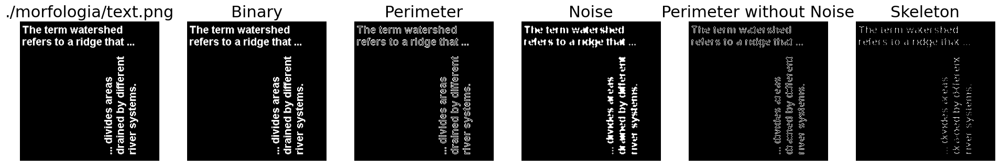

In [107]:
image =  readGrayscaleimage('./morfologia/text.png')
threshold = threshold_isodata(image)
show_perimeter_and_noise('./morfologia/text.png', threshold, Structural_element.diamond(size=3), Padding.zero_padding)
print('t = ',threshold)

**Análisis letras**

Se utulizó el algoritmo isodata con umbral 127 puers este conseba mejor las letras. Las letras al ser delgadas se produjo contornos delgados pero con letra entendibles. Así, si queremos aplicar reducción de ruido estas letras se distorcionarán y perderán forma. El esqueleto conserva la forma de las letras pero a un ancho de un píxel. Para las operaciones se usó el elemento estructural diamante de tamaño 3 y padding cero.

# **5. Escala de grises**

## 5. 1. **Código**

In [70]:
def show_gray_morphological_operations(pathImage, array_structural_element, padding_mode):
    
    #read image with gray scale
    
    grayImage = readGrayscaleimage(pathImage)
    grayImage = np.asarray(grayImage)
    extension = '.png'
    
    if pathImage.find('.jpg') != -1:
         extension = '.jpg'
    if pathImage.find('.png') != -1:
         extension = '.png'
     
    plt.figure(figsize=(24,7)) # size of image
            
    #original image
    plt.subplot(1,5,1)
    plt.imshow(grayImage, cmap= plt.cm.gray)
    plt.title(f'Original: {pathImage}', fontsize=22)
    plt.axis('off')
    
    #Dilatation
    G = grey_dilation(input=grayImage, structure=array_structural_element, mode=padding_mode)
    plt.subplot(1,5,2)
    plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
    plt.title('Dilatation', fontsize=22)
    plt.axis('off')
    
    
    #Erosion
    G = grey_erosion(input=grayImage, structure=array_structural_element, mode=padding_mode)
    plt.subplot(1,5,3)
    plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
    plt.title('Erosion', fontsize=22)
    plt.axis('off')
    
    
    #Opening
    G = grey_opening(input=grayImage, structure=array_structural_element, mode=padding_mode)
    plt.subplot(1,5,4)
    plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
    plt.title('Opening', fontsize=22)
    plt.axis('off')
    
    
    #Closing
    G = grey_closing(input=grayImage, structure=array_structural_element, mode=padding_mode)
    plt.subplot(1,5,5)
    plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
    plt.title('Closing', fontsize=22)
    plt.axis('off')

(-0.5, 320.5, 480.5, -0.5)

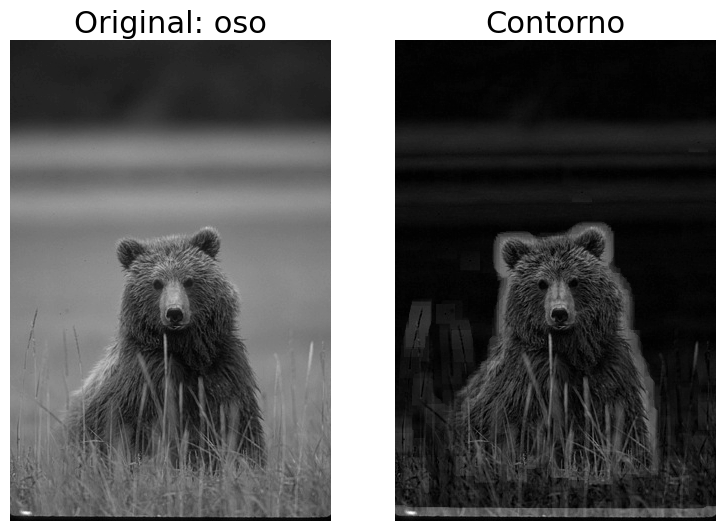

In [71]:
#load image
greyImage = readGrayscaleimage('./morfologia/100080.png')


greyImage = np.asarray(greyImage)
kernel = Structural_element.cross(size=19)[0]



plt.figure(figsize=(24,7)) # size of image

#original image
plt.subplot(1,5,1)
plt.imshow(greyImage, cmap= plt.cm.gray)
plt.title(f'Original: oso', fontsize=22)
plt.axis('off')


#operation
erosion = grey_erosion(input=greyImage, structure=kernel, mode='reflect')
processed = greyImage - erosion


plt.subplot(1,5,2)
plt.imshow(processed, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Contorno', fontsize=22)
plt.axis('off')

**Análisis Oso**
Se aplica una operación de erosión gris a la imagen original utilizando un elemento estructural en forma de cruz con un tamaño de 19  y padding debido que existe presencia de pelo que queremos descartar. Luego, se calcula la diferencia entre la imagen original y la imagen erosionada. Esto resalta los contornos y bordes del oso en la imagen. Estas operaciones crean un contorno resaltante al rededor del cuerpo del oso sin afectar su pelaje y rostro.

(-0.5, 320.5, 480.5, -0.5)

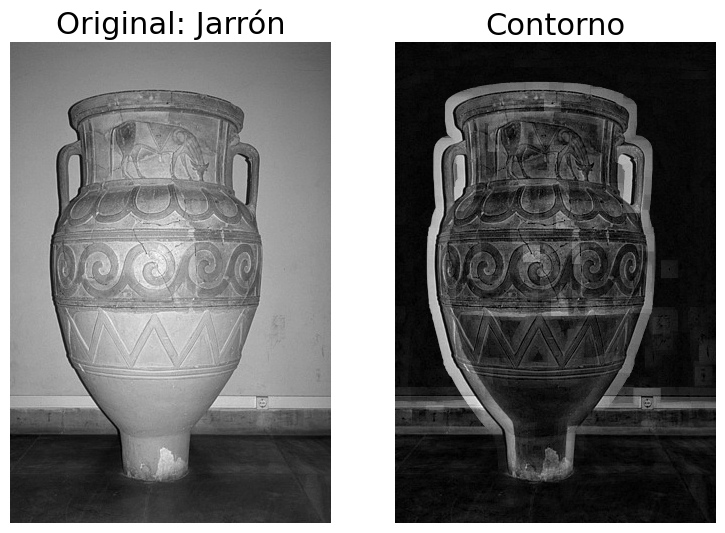

In [34]:
#load image
greyImage = readGrayscaleimage('./morfologia/227092.png')

greyImage = np.asarray(greyImage)
kernel = Structural_element.diamond(size=17)[0]


plt.figure(figsize=(24,7)) # size of image

#original image
plt.subplot(1,5,1)
plt.imshow(greyImage, cmap= plt.cm.gray)
plt.title(f'Original: Jarrón', fontsize=22)
plt.axis('off')

#skeleton
erosion = grey_erosion(input=greyImage, structure=kernel, mode='reflect')
processed = greyImage - erosion


plt.subplot(1,5,2)    
plt.imshow(processed, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Contorno', fontsize=22)
plt.axis('off')

**Análisis**

Se aplica una operación de erosión gris a la imagen original utilizando un elemento estructural en forma de diamante con un tamaño de 17 y padding reflejo. Luego,  se calcula la diferencia entre la imagen original y la imagen erosionada. Esto resalta los contornos y bordes del jarrón en la imagen.



(-0.5, 299.5, 245.5, -0.5)

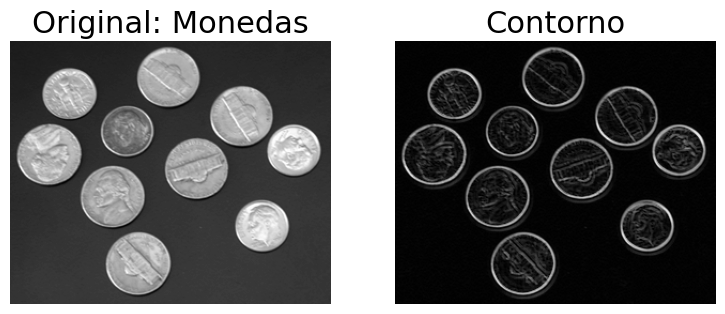

In [37]:
#load image
greyImage = readGrayscaleimage('./morfologia/coins.png')

greyImage = np.asarray(greyImage)
kernel = Structural_element.diamond(size=5)[0]


plt.figure(figsize=(24,7)) # size of image

#original image
plt.subplot(1,5,1)
plt.imshow(greyImage, cmap= plt.cm.gray)
plt.title(f'Original: Monedas', fontsize=22)
plt.axis('off')

#skeleton
erosion = grey_erosion(input=greyImage, structure=kernel, mode='reflect')
processed = greyImage - erosion


plt.subplot(1,5,2)    
plt.imshow(processed, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Contorno', fontsize=22)
plt.axis('off')

**Análisis**

Se aplica una operación de erosión gris a la imagen original utilizando un elemento estructural en forma de diamante con un tamaño de 5 y padding reflejo debido a que los bordes son delgados. La erosión gris reduce el tamaño de las regiones brillantes en la imagen.Luego, calculamos la diferencia entre la imagen original y la imagen erosionada. Esto resalta los contornos y bordes de las monedas en la imagen.



(-0.5, 399.5, 479.5, -0.5)

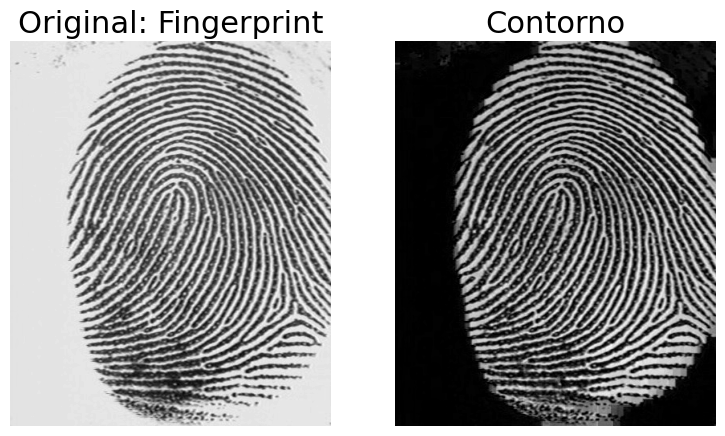

In [67]:
grayImage = readGrayscaleimage('./morfologia/fingerprint.png')
grayImage = np.asarray(grayImage)
kernel = Structural_element.circle(size=15)[0]

plt.figure(figsize=(24,7)) # size of image

#original image
plt.subplot(1,5,1)
plt.imshow(grayImage, cmap= plt.cm.gray)
plt.title(f'Original: Fingerprint', fontsize=22)
plt.axis('off')



# operation


dilation = grey_dilation(input=grayImage, structure=kernel, mode='reflect')
X = dilation - grayImage
X = black_tophat(input=X, structure=kernel, mode='reflect')


plt.subplot(1,5,2)    
plt.imshow(X, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Contorno', fontsize=22)
plt.axis('off')

**Análisis**

Se aplica una dilatación gris a la imagen original utilizando un kernel en forma de círculo con un tamaño de 15 y padding reflejo porque quermos conservar los bordes de las curvas de las líneas. 

Se calcula la diferencia entre la imagen dilatada y la imagen original. Esto resalta las regiones donde la dilatación ha generado cambios.

Se aplica la operación "tapa negra" a la imagen obtenida después de la resta. Esta operación sustrae la imagen dilatada original de la imagen original y ayuda a resaltar los contornos o características de interés en la imagen.

(-0.5, 239.5, 319.5, -0.5)

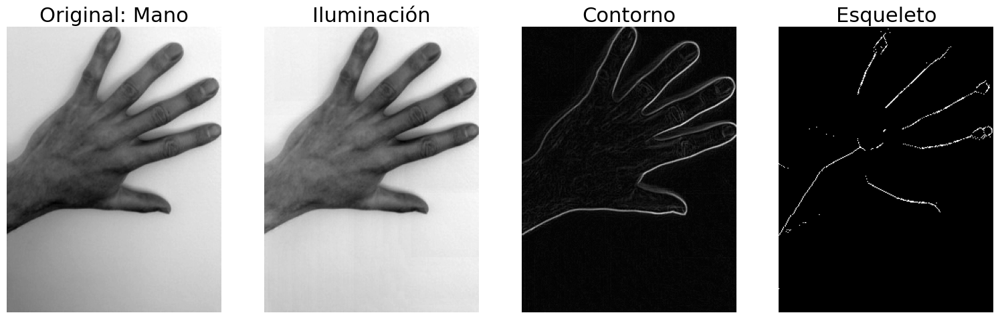

In [128]:
greyImage = readGrayscaleimage('./morfologia/hands1.png')

greyImage = np.asarray(greyImage)
kernel = Structural_element.diamond(size=151)[0]

plt.figure(figsize=(24,7)) # size of image

#original image
plt.subplot(1,5,1)
plt.imshow(greyImage, cmap= plt.cm.gray)
plt.title(f'Original: Mano', fontsize=22)
plt.axis('off')


G = grey_dilation(input=greyImage, structure=kernel, mode='reflect')
G = greyImage - G

plt.subplot(1,5,2)
plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Iluminación', fontsize=22)
plt.axis('off')

#skeleton
X = grey_erosion(input=G, structure=Structural_element.diamond(size=3)[0], mode='reflect')
G = G - X

plt.subplot(1,5,3)
plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Contorno', fontsize=22)
plt.axis('off')


img = greyImage.copy()
skeleton = np.zeros(img.shape, dtype=np.uint8)
t = threshold_niblack(img, 1023, k=0.5)
img = np.where(img < t, 1, 0)
img = img.astype(np.uint8)
while True:
    opened = binary_opening(input=img, structure=Structural_element.diamond(size=3)[0])
    subtraction = img ^ opened
    eroded = binary_erosion(input=img, structure=Structural_element.diamond(size=3)[0])
    skeleton = np.bitwise_or(skeleton.astype(np.int32),subtraction.astype(np.int32))
    img = eroded.copy()
    if np.count_nonzero(img) == 0:
        break
    
plt.subplot(1,5,4)
plt.imshow(skeleton*255, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Esqueleto', fontsize=22)
plt.axis('off')



**Análisis**

Aplicamos dilatación gris a la imagen original utilizando un kernel en forma de diamante con un tamaño de 151 con padding reflejo.
Calculamos la diferencia entre la imagen original y la imagen obtenida después de la dilatación. Esto permite resaltar las áreas que fueron ampliadas por la dilatación, lo cual puede indicar zonas de iluminación o brillo en la imagen.

Realizamos una erosión gris en la imagen resultante de la resta utilizando un kernel en forma de diamante con un tamaño de 3. La erosión gris suaviza las áreas brillantes y puede ayudar a obtener el contorno de los objetos.

Restamos las imagenes nuevamente y calculamos la diferencia entre la imagen resultante de la resta y la imagen obtenida después de la erosión. Esto resalta el contorno de los objetos en la imagen original.

Finalmente se ejecuta un proceso iterativo de umbralización y esqueletización para obtener el esqueleto de la imagen. Primero, se aplica un umbral utilizando el método de Niblack. Luego, se realiza una serie de operaciones de erosión, apertura binaria y diferencia simétrica para obtener gradualmente el esqueleto de la imagen. El proceso continúa hasta que no queden píxeles en la imagen. El resultado son líneas que representan la muñeca, mano y los 5 dedos.

(-0.5, 605.5, 755.5, -0.5)

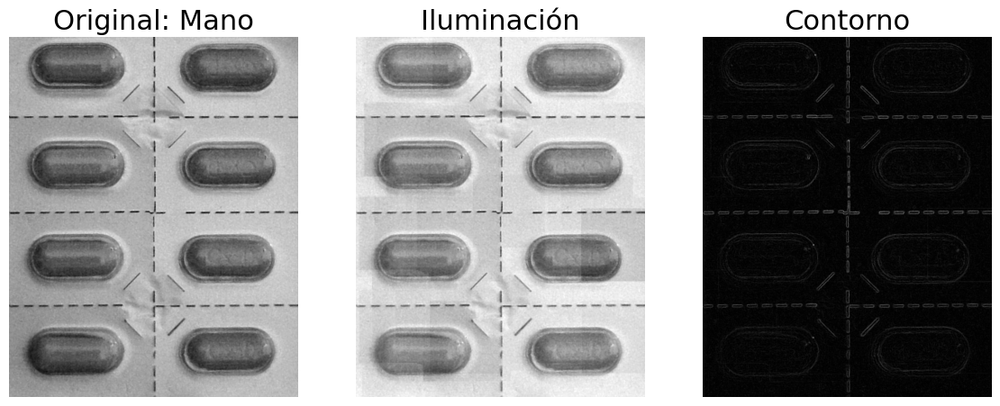

In [141]:
greyImage = readGrayscaleimage('./morfologia/pills.png')

greyImage = np.asarray(greyImage)
kernel = Structural_element.diamond(size=151)[0]

plt.figure(figsize=(24,7)) # size of image

#original image
plt.subplot(1,5,1)
plt.imshow(greyImage, cmap= plt.cm.gray)
plt.title(f'Original: Mano', fontsize=22)
plt.axis('off')


G = grey_dilation(input=greyImage, structure=kernel, mode='reflect')
G = greyImage - G

plt.subplot(1,5,2)
plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Iluminación', fontsize=22)
plt.axis('off')

#skeleton
X = grey_erosion(input=G, structure=Structural_element.diamond(size=3)[0], mode='reflect')
G = G - X


 


plt.subplot(1,5,3)
plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Contorno', fontsize=22)
plt.axis('off')

**Análisis**

Aplicamos dilatación gris a la imagen original utilizando un kernel en forma de diamante con un tamaño de 151 con padding reflejo. 
Calculamos la diferencia entre la imagen original y la imagen obtenida después de la dilatación. Esto permite resaltar las áreas que fueron ampliadas por la dilatación, lo cual puede indicar zonas de iluminación o brillo en la imagen.

Luego realizamos una erosión gris en la imagen resultante de la resta utilizando un kernel en forma de diamante con un tamaño de 3. La erosión gris suaviza las áreas brillantes y puede ayudar a obtener el contorno de las píldoras.


(-0.5, 331.5, 167.5, -0.5)

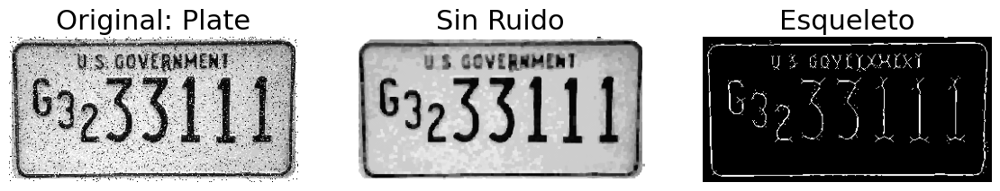

In [131]:
greyImage = readGrayscaleimage('./morfologia/platesp.png')
greyImage = np.asarray(greyImage)

plt.figure(figsize=(24,7)) # size of image

#original image
plt.subplot(1,5,1)
plt.imshow(greyImage, cmap= plt.cm.gray)
plt.title(f'Original: Plate', fontsize=22)
plt.axis('off')




G = grey_opening(input=greyImage, structure=Structural_element.diamond(size=3)[0], mode='reflect')
G = grey_closing(input=G, structure=Structural_element.diamond(size=3)[0], mode='reflect')



plt.subplot(1,5,2)
plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Sin Ruido', fontsize=22)
plt.axis('off')


img = G.copy()
skeleton = np.zeros(img.shape, dtype=np.uint8)
t = threshold_niblack(img, 1023, k=0.5)
img = np.where(img < t, 1, 0)
img = img.astype(np.uint8)
while True:
    opened = binary_opening(input=img, structure=Structural_element.diamond(size=3)[0])
    subtraction = img ^ opened
    eroded = binary_erosion(input=img, structure=Structural_element.diamond(size=3)[0])
    skeleton = np.bitwise_or(skeleton.astype(np.int32),subtraction.astype(np.int32))
    img = eroded.copy()
    if np.count_nonzero(img) == 0:
        break
    
plt.subplot(1,5,3)
plt.imshow(skeleton*255, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Esqueleto', fontsize=22)
plt.axis('off')

**Análisis**

Realizamos una apertura gris en la imagen original utilizando un kernel en forma de diamante con un tamaño de 3 con padding reflejo. La apertura gris suaviza las regiones brillantes y puede ayudar a eliminar el ruido o detalles indeseados.

Tambien para el cierre gris en la imagen resultante de la apertura gris utilizando el mismo kernel en forma de diamante. El cierre gris puede ayudar a cerrar huecos o unir regiones de la imagen.

Y por último un proceso iterativo de umbralización y esqueletización para obtener el esqueleto de la imagen. Primero, se aplica un umbral utilizando el método de Niblack. Luego, se realiza una serie de operaciones de erosión, apertura binaria y diferencia simétrica para obtener gradualmente el esqueleto de la imagen. El proceso continúa hasta que no queden píxeles en la imagen. El resultado es los queletos de los números y letras en un ancho de un píxel.

(-0.5, 255.5, 255.5, -0.5)

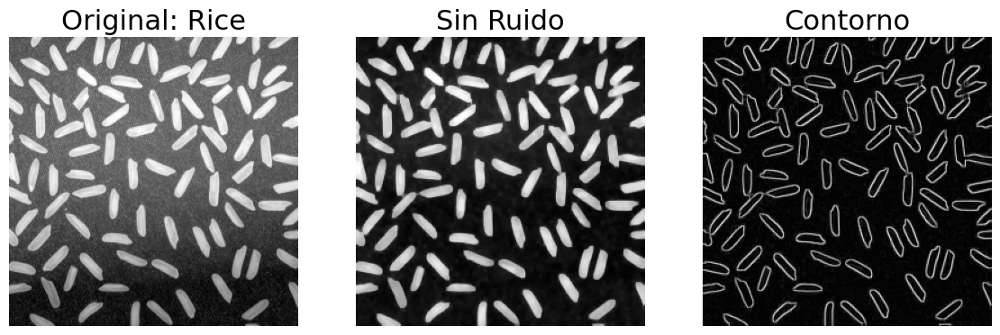

In [17]:
greyImage = readGrayscaleimage('./morfologia/rice.png')

greyImage = np.asarray(greyImage)
kernel = Structural_element.circle(size=151)[0]

plt.figure(figsize=(24,7)) # size of image

#original image
plt.subplot(1,5,1)
plt.imshow(greyImage, cmap= plt.cm.gray)
plt.title(f'Original: Rice', fontsize=22)
plt.axis('off')




G = white_tophat(input=greyImage, structure=kernel, mode='reflect')
G = grey_opening(input=G, structure=Structural_element.diamond(size=3)[0], mode='reflect')
G = grey_closing(input=G, structure=Structural_element.diamond(size=3)[0], mode='reflect')



plt.subplot(1,5,2)
plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Sin Ruido', fontsize=22)
plt.axis('off')


X = grey_erosion(input=G, structure=Structural_element.diamond(size=3)[0], mode='reflect')
G = G - X   
plt.subplot(1,5,3)
plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Contorno', fontsize=22)
plt.axis('off')

**Análisis**

Aplicado a la imégen original Rice (Arroz)

Realizamos una operación de tophat blanco a la imagen original utilizando un kernel en forma de círculo con un tamaño de 151 padding reflejo debido que queremos un resaltado de intensidades suaves. El tophat blanco resalta las regiones brillantes y pequeñas estructuras en la imagen que contrastan con el fondo.

Por otra parte se realiza una apertura de gris en la imagen resultante del tophat blanco utilizando un elemento estructural de tipo diamante con tamaño 3. La apertura gris suaviza los contornos y elimina pequeños detalles o ruido en la imagen.

También se realiza un cierre gris en la imagen resultante de la apertura gris utilizando un elemento estructural de tipo diamante con tamaño 3. El cierre gris ayuda a unir regiones y eliminar pequeñas aberturas en la imagen.

Se realiza una umbralización de Niblack en la imagen procesada anteriormente para obtener una imagen binaria. Este umbral adaptativo permite separar las regiones de interés del fondo en función de la intensidad local de los píxeles.

Por último se aplica el algoritmo de esqueletonización a la imagen binaria utilizando operaciones de erosión y diferencia entre imágenes binarias. Esto permite obtener el esqueleto del arroz.

(-0.5, 799.5, 599.5, -0.5)

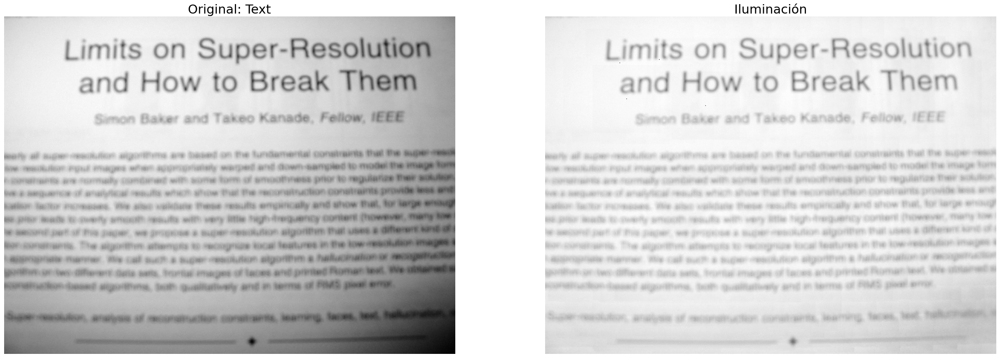

In [14]:
greyImage = readGrayscaleimage('./morfologia/blur.png')

greyImage = np.asarray(greyImage)
kernel = Structural_element.cross(size=121)[0]

plt.figure(figsize=(48,14)) # size of image

#original image
plt.subplot(1,3,1)
plt.imshow(greyImage, cmap= plt.cm.gray)
plt.title(f'Original: Text', fontsize=22)
plt.axis('off')


dilation = grey_dilation(input=greyImage, structure=kernel, mode='reflect')
G = greyImage - dilation



#Iluminación
plt.subplot(1,3,2)
plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Iluminación', fontsize=22)
plt.axis('off')



**Análisis**


Como podemos observar, tenemos la imágene original que se le aplica las siguientes operaciones:

Se aplica una operación de dilatación gris a la imagen original utilizando un kernel en forma de cruz con un tamaño de 121 y padding reflejo. Luego, Hayamos la diferencia entre la imagen original y la imagen obtenida después de la dilatación. Esto permite resaltar las regiones que fueron reducidas por la dilatación y elimina sombras.

(-0.5, 255.5, 255.5, -0.5)

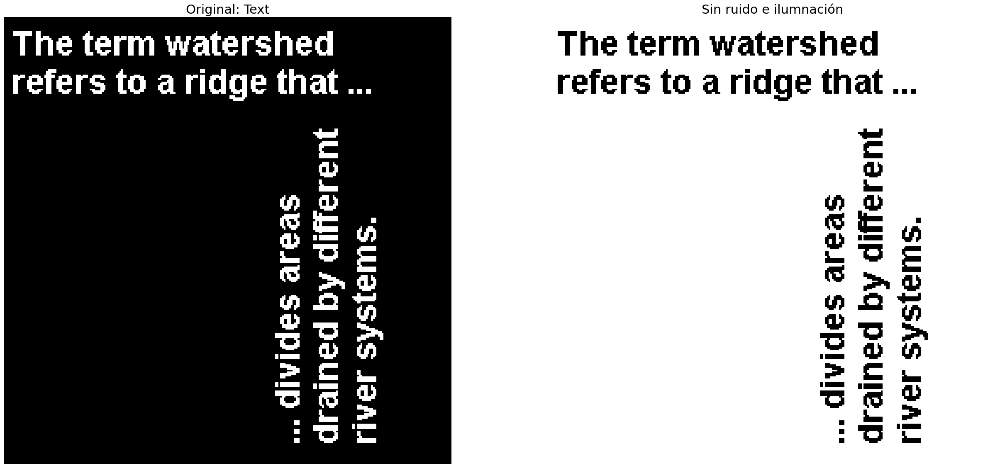

In [117]:
greyImage = readGrayscaleimage('./morfologia/text.png')
greyImage = np.asarray(greyImage)
kernel = Structural_element.circle(size=17)[0]
plt.figure(figsize=(48,14)) # size of image

#original image
plt.subplot(1,3,1)
plt.imshow(greyImage, cmap= plt.cm.gray)
plt.title(f'Original: Text', fontsize=22)
plt.axis('off')

G = white_tophat(input=greyImage, structure=kernel, mode='reflect')

#Iluminación
plt.subplot(1,3,2)
plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Sin ruido e ilumnación', fontsize=22)
plt.axis('off')


**Análisis de la Imágen**

Tenemos la imágenes original en escala de grises llamada que realiza la operación de "Tophat blanco" que se aplica una operación de tophat blanco a la imagen original con kernel 17 en forma de circulo y padding reflejo debido que este ensuaviza los bordes de las letras y las conserva. Esta operación resalta las regiones brillantes y pequeñas estructuras en la imagen que contrastan con el fondo.
Lo que se hace es procesar la imagen original utilizando una operación de tophat blanco para resaltar regiones brillantes y pequeñas estructuras. Podemos ver el resultado de esta operación.

(-0.5, 1199.5, 1599.5, -0.5)

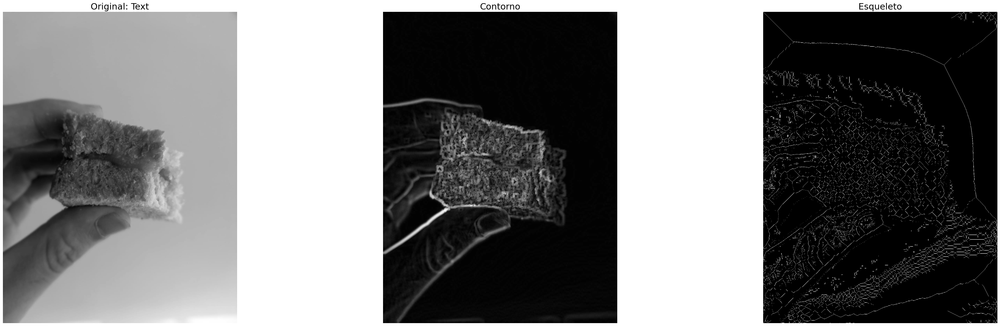

In [137]:
greyImage = readGrayscaleimage('./morfologia/pan.png')

greyImage = np.asarray(greyImage)
kernel = Structural_element.cross(size=25)[0]

plt.figure(figsize=(48,14)) # size of image

#original image
plt.subplot(1,3,1)
plt.imshow(greyImage, cmap= plt.cm.gray)
plt.title(f'Original: Text', fontsize=22)
plt.axis('off')


dilation = grey_dilation(input=greyImage, structure=kernel, mode='reflect')
G =  dilation - greyImage




#Iluminación
plt.subplot(1,3,2)
plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Contorno', fontsize=22)
plt.axis('off')


img = G.copy()
skeleton = np.zeros(img.shape, dtype=np.uint8)
t = threshold_niblack(img, 1023, k=0.5)
img = np.where(img > t, 1, 0)
img = img.astype(np.uint8)
while True:
    opened = binary_opening(input=img, structure=Structural_element.diamond(size=3)[0])
    subtraction = img ^ opened
    eroded = binary_erosion(input=img, structure=Structural_element.diamond(size=3)[0])
    skeleton = np.bitwise_or(skeleton.astype(np.int32),subtraction.astype(np.int32))
    img = eroded.copy()
    if np.count_nonzero(img) == 0:
        break
    
plt.subplot(1,3,3)
plt.imshow(skeleton*255, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Esqueleto', fontsize=22)
plt.axis('off')

**Análisis de imagen Pan**

Para el contorno, se aplicó una dilatación a la imgen en grises con kernel 25 y padding reflejo (Deberia ser erosión pero aqui el objeto presenta tonos oscuros y el fondo claros), luego esta restó a la imagen en grises. Para el esqueleto se usó kernel tamaño 3 con padding reflejo debido a que se quiere conservar cada detalle. La imagen en grises pasó por un proceso de binarización utilizando el algoritmo de niblack. Con la imagen binaria, se aplicó la operación de apertura. Luego se le resto la imagen binaria original utilizando XOR obteniendo un conjunto del esqueleto, luego se obtuvo la erosion de la imagen binaria para luego aplicar el operador OR uniendo el esqueleto con la erosion repitiendo estos pasos hasta que no exista unos en la imagen binaria. 

Se delimitó muy bien el contorno del pan y la mano pero tambien se resaltó mucho los pixeles que corresponden a la miga. Un fultro Gaussiano solucionaría este problema ensuavizando esta area. En el esqueleto si se obtuvieron los esqueletos de las figuras pero tambien se formó esqueleto del fondo por las sombras. 

(-0.5, 899.5, 1599.5, -0.5)

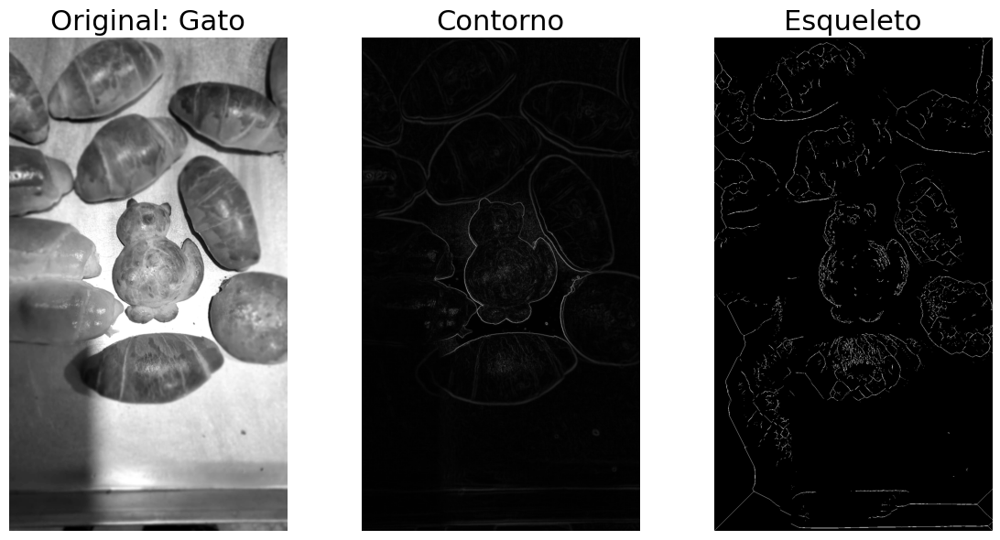

In [142]:
greyImage = readGrayscaleimage('./morfologia/gato.png')
greyImage = np.asarray(greyImage)

plt.figure(figsize=(24,7)) # size of image

#original image
plt.subplot(1,5,1)
plt.imshow(greyImage, cmap= plt.cm.gray)
plt.title(f'Original: Gato', fontsize=22)
plt.axis('off')

G = np.copy(greyImage)



#contorno
X = grey_erosion(input=G, structure=Structural_element.circle(size=3)[0], mode='reflect')
G = G - X



 


plt.subplot(1,5,2)
plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Contorno', fontsize=22)
plt.axis('off')



img = greyImage.copy()
skeleton = np.zeros(img.shape, dtype=np.uint8)
t = threshold_niblack(img, 1023, k=0.5)
img = np.where(img < t, 1, 0)
img = img.astype(np.uint8)
while True:
    opened = binary_opening(input=img, structure=Structural_element.diamond(size=3)[0])
    subtraction = img ^ opened
    eroded = binary_erosion(input=img, structure=Structural_element.diamond(size=3)[0])
    skeleton = np.bitwise_or(skeleton.astype(np.int32),subtraction.astype(np.int32))
    img = eroded.copy()
    if np.count_nonzero(img) == 0:
        break
    
plt.subplot(1,5,3)
plt.imshow(skeleton*255, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Esqueleto', fontsize=22)
plt.axis('off')

**Análisis de imagen Gato**

Para el contorno, se aplicó una erosión a la imgen en grises con kernel tamaño 3 diamante y padding reflejo debido a que conserva mejor las curvas, luego esta restó a la imagen en grises. Para el esqueleto, la imagen en grises pasó por un proceso de binarización utilizando el algoritmo de niblack. Con la imagen binaria, se aplicó la operación de apertura. Luego se le resto la imagen binaria original utilizando XOR obteniendo un conjunto del esqueleto, luego se obtuvo la erosion de la imagen binaria para luego aplicar el operador OR uniendo el esqueleto con la erosion repitiendo estos pasos hasta que no exista unos en la imagen binaria. 

Se delimitó muy bien el contorno del pan en forma de gato pero la sombra afectó dos panes. En el esqueleto si se obtuvieron los esqueletos de las figuras. 

(-0.5, 959.5, 1279.5, -0.5)

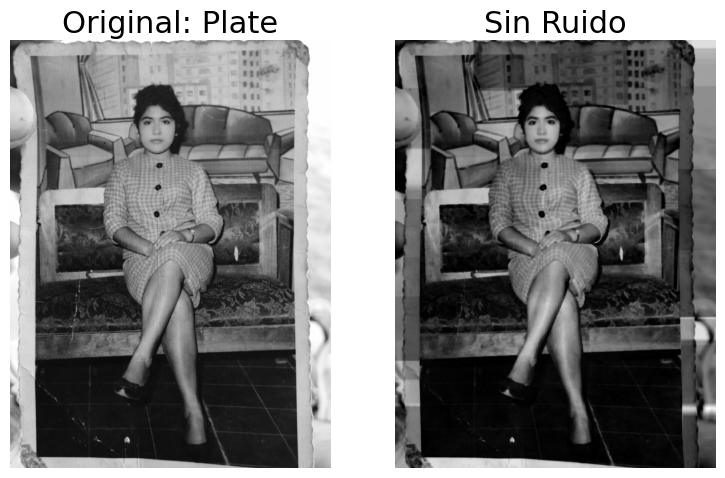

In [195]:
greyImage = readGrayscaleimage('./morfologia/foto.png')
greyImage = np.asarray(greyImage)

plt.figure(figsize=(24,7)) # size of image

#original image
plt.subplot(1,5,1)
plt.imshow(greyImage, cmap= plt.cm.gray)
plt.title(f'Original: FOTO', fontsize=22)
plt.axis('off')


kernel = Structural_element.circle(size=151)[0]
G = white_tophat(input=greyImage, structure=kernel, mode='reflect')
G = grey_opening(input=G, structure=Structural_element.diamond(size=3)[0], mode='reflect')
G = grey_closing(input=G, structure=Structural_element.diamond(size=3)[0], mode='reflect')
G = grey_erosion(input=G, structure=Structural_element.circle(size=3)[0], mode='reflect')


plt.subplot(1,5,2)
plt.imshow(G, cmap= plt.cm.gray) #show gray level  (2 levels)
plt.title('Sin Ruido', fontsize=22)
plt.axis('off')

**Análisis de FOTO**

Utilizando un kernel de diamante de 151 de lado con padding reflejo. Se procedió utilizar la opración white_tophat para resaltar pixeles más brillantes como el rotro, las piernas, eliminando ruido provocados por pixeles que no encajan en su vecindario. Luego se aplicó una apertura y una clausura seguida con un kernel de 3 de longitud en diamante para eliminar el ruido como el del piso. Finalmente se aplica una erosion con un kernel de circulo para reducir el tamaño de las arrugas de la foto.

#  Conclusión

Se conluye que el uso de la morfología matemática ayuda a realizar mejoras y correcciones a la imágenes. Esta corregiones por la expriencia de este laboratorio se pueden realizar con elementos estructurales diamante y círculo. EL círculo es muy bueno para ensuavizar la imágen. Este puede usarse en las operaciones de quitar ruido (apertura y clausura), las operaciones white o black tophat. Para las opraciones de contorno, erosion o dilatación es mejor usar el operador de diamante de tamaño 3 o 5. Si estamos utilizando un mejora de iluminación se debe utilizar un elemento estructural superior a 121. Si una imagen tiene mucho ruido sal y pimienta, el umbral de otsu corregirá gran parte de eso seguido de una apertura y una clausura. Para correguir arrugas en foto las operaciones white o black tophat son la mejor opción. Los umbrales Niblack e Isodata presentan la moyoría de casos con mejor estética. El umbral de kapur conserva la mprfología de los objetos como se observó en las monedas.  
